# Dog Segmentation

### $U^2 Net$
U2-Net is a U-structure architecture deep learning model designed for salient object detection and semantic segmentation. The goal is to distinguish between salient and non-salient regions. Salient Object Detection is a key task in computer vision to accurately detect and segment areas of an image that are visually prominent from a human visual system perspective.
There are comparable architectures with U2-Net, such as UNet, a highly popular model for semantic segmentation, MaskRCNN,  which use a Region Proposal Network to propose object bounding boxes, then classifies the proposed boxes and generates predicted bounding boxes and masks.

### Objective
To precisely detect and segment the dogs from the images.


### Dataset
Dog Segmentation dataset from Kaggle (https://www.kaggle.com/datasets/santhoshkumarv/dog-segmentation-dataset)

### Data Preparation
70% of the dataset is in the training dataset and 30% validation dataset.

### EDA
- Image Level Analysis - Analyse the distribution of the image in terms of height, width, and aspect ratio
- Object Level Analysis - Categorize the dataset into 3 different object size groups. The following means the percentage of dog mask compared to the image size. 
    - Large (dog >= 60)
    - Medium (30 < dog < 60)
    - Small (dog <= 30)

### Model Training
The model trains with Adam optimizer and muti_bce_loss_fusion, which computes binary cross entropy loss for each prediction made at different stages of U2-Net and then sum up those losses. (epochs = 400, batch_size = 6, optimizer = Adam, loss_function = multi_bce_loss_function)

### Performance Evaluation
IoU (Intersection over Union) is used to evaluate the model performance. IoU is a metric used in object detection that measures the overlap between two bounding boxes, specifically, the area of overlap divided by the area of union, to assess the accuracy of a predicted bounding box in relation to the true box.<br>
Recall is calculated with IoU threshold >= 0.6 (True Positive if IoU >= 0.6 otherwise False Negative).

In [5]:
!pip install opencv-python

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.7/61.7 MB 15.6 MB/s eta 0:00:00m eta 0:00:010:00:01


## Import Libraries

In [6]:
import os
import torch
import torchvision
from torch.autograd import Variable
import torch.nn as nn
import torch.nn.functional as F

from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
import torch.optim as optim
import torchvision.transforms as standard_transforms

import numpy as np
import glob
import os

from data_loader import Rescale
from data_loader import RescaleT
from data_loader import RandomCrop
from data_loader import ToTensor
from data_loader import ToTensorLab
from data_loader import SalObjDataset

from model import U2NET
from PIL import Image

import cv2
import matplotlib.pyplot as plt
import random
from skimage import io, transform


## Understanding the Dataset

In [26]:
data_dir = 'Dog_Segmentation'
train_img = os.path.join(data_dir +'/Images/')
train_mask = os.path.join(data_dir +'/Labels/')

image_ext = '.jpg'
label_ext = '.jpg'

img_list = glob.glob(train_img + '*' + image_ext)

label_list = []
for img_path in img_list:
    img_name = img_path.split(os.sep)[-1]
    
    datum = img_name.split(".")
    dog_id = datum[1]
    
    label_list.append(train_mask + 'annotated_dog.' + dog_id + label_ext)

In [28]:
img_list[:3]

['Dog_Segmentation/Images/dog.8900.jpg',
 'Dog_Segmentation/Images/dog.8891.jpg',
 'Dog_Segmentation/Images/dog.8950.jpg']

In [27]:
label_list[:3]

['Dog_Segmentation/Labels/annotated_dog.8900.jpg',
 'Dog_Segmentation/Labels/annotated_dog.8891.jpg',
 'Dog_Segmentation/Labels/annotated_dog.8950.jpg']

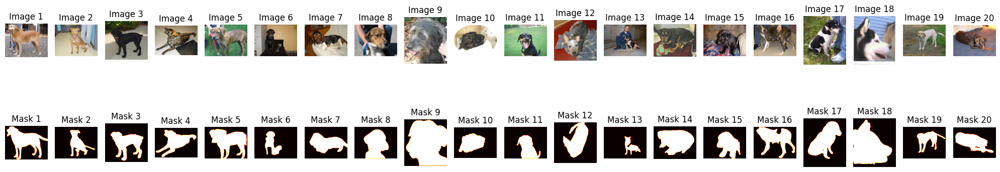

In [25]:
fig, axs = plt.subplots(2, 20, figsize=(20, 5))
for i in range(20):
    axs[0, i].imshow(Image.open(img_list[i]), cmap='gray')
    axs[0, i].axis('off')
    axs[0, i].set_title(f'Image {i+1}')

for i in range(20):
    axs[1, i].imshow(Image.open(label_list[i]), cmap='hot')
    axs[1, i].axis('off')
    axs[1, i].set_title(f'Mask {i+1}')

plt.tight_layout()
plt.show()  

The data provides original images and its corresponding binary mask images. The binary mask seems precise and well annotated. 

## Prepare Training and Validation Dataset

In [30]:
# 70% training data, 30% validation dataset
split_size = 0.7
train_last_idx = int(len(img_list)*0.7)

train_img_list = img_list[:train_last_idx]
train_label_list = label_list[:train_last_idx]

val_img_list = img_list[train_last_idx:]
val_label_list = label_list[train_last_idx:]

print("train images: ", len(train_img_list))
print("train labels: ", len(train_label_list))

print("validation images: ", len(val_img_list))
print("validation labels: ", len(val_label_list))


train images:  125
train labels:  125
validation images:  55
validation labels:  55


The data is split into training and validation dataset. 70% training dataset and 30% validation dataset.

## Data Exploration and Analysis

In [36]:
import seaborn as sns

def data_distribution(dataset):
    
    # Image-Level Analysis
    
    # 1. Number of images in the dataset
    num_images = len(dataset)
    print('Number of images: ', num_images)
    
    # 2. Image size distribution and aspect ratio
    
    heights = [Image.open(img).size[0] for img in dataset]
    widths = [Image.open(img).size[1] for img in dataset]
    
    # Plot size distributions
    plt.figure(figsize=(14, 4))
    
    plt.subplot(1, 3, 1)
    sns.histplot(heights, bins=50)
    plt.title('Height Distribution')
    
    plt.subplot(1, 3, 2)
    sns.histplot(widths, bins=50)
    plt.title('Width Distribution')
    
    plt.subplot(1, 3, 3)
    sns.histplot(np.array(widths) / np.array(heights), bins=50)
    plt.title('Aspect Ratio (Width/Height) Distribution')
    
    plt.tight_layout()
    plt.show()

def size_distribution(dataset):
    object_grps = []
    for mask in dataset:
        mask = cv2.imread(mask, cv2.IMREAD_GRAYSCALE)
        
        # Find contours
        contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        # Compute the area of the polygon
        largest_contour = max(contours, key = cv2.contourArea) # Get the largest contour if there are multiple
        segmentation_area = cv2.contourArea(largest_contour)
        total_area = mask.size
    
        # Compute the percentage
        percentage = (segmentation_area / total_area) * 100
    
        if percentage >= 60:
            group = 'large'
        elif percentage <= 30:
            group = 'medium'
        else:
            group = 'small'
        object_grps.append(group)        
    
    plt.figure(figsize=(6, 6))
    sns.histplot(sorted(object_grps), bins=50)
    plt.title('Object Size Distribution')

def plot(path1, path2):   
    
    image1 = Image.open(path1)
    image2 = Image.open(path2)
    plt.figure()

    plt.subplot(1, 2, 1)
    plt.imshow(image1)
    plt.axis('off') 

    plt.subplot(1, 2, 2)
    plt.imshow(image2)
    plt.axis('off')
    
    plt.show()


### Dataset Exploration

Number of images:  125


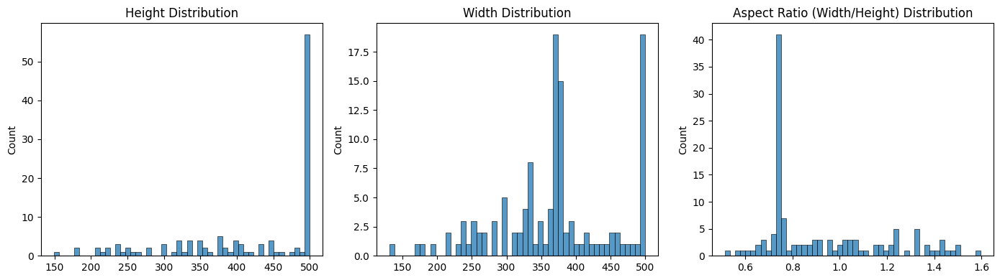

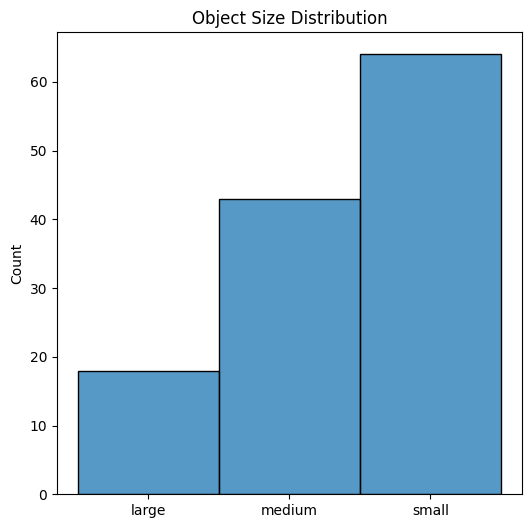

In [37]:
# Training Data Distribution
data_distribution(train_img_list)
size_distribution(train_label_list)

Number of images:  55


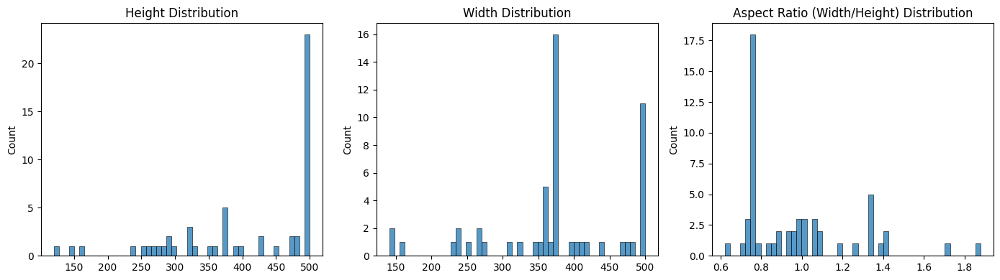

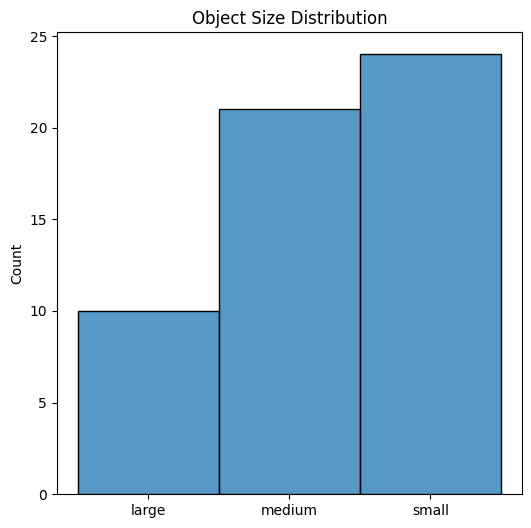

In [38]:
# Validation Data Distribution
data_distribution(val_img_list)
size_distribution(val_label_list)

### Highlight of EDA Analaysis 
- The dataset does not have the fixed-size of the images and also there is some disparity in dimension.
- Dataset does not have a lot of extreme aspect ratio which might lead to a distortion of the image. The distorted images are not good for the model to learn and generalize.
- Both training and validation datasets does not have balanced distribution of the size of the dog compared to image. Typically, it is better to have balanced distribution of sizes for the model to learn and generalize better.

### Visualize Object by Object Size

In [39]:
small = []
medium = []
large = []

for i, mask in enumerate(train_label_list):
    mask = cv2.imread(mask, cv2.IMREAD_GRAYSCALE)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    largest_contour = max(contours, key = cv2.contourArea) # Get the largest contour if there are multiple
    segmentation_area = cv2.contourArea(largest_contour)
    total_area = mask.size
    percentage = (segmentation_area / total_area) * 100

    if percentage >= 60:
        large.append(i)
    elif percentage <= 30:
        small.append(i)
    else:
        medium.append(i)

#### Large Sized Dog Object

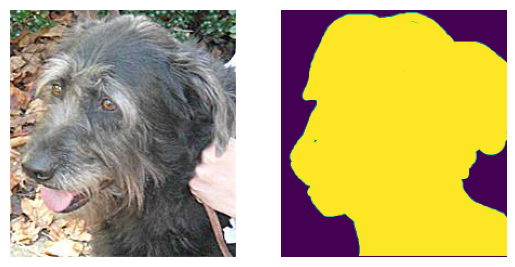

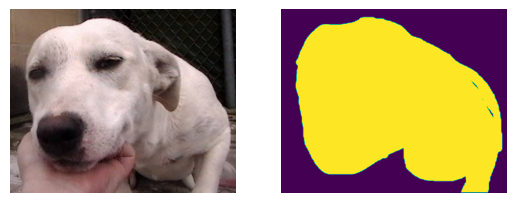

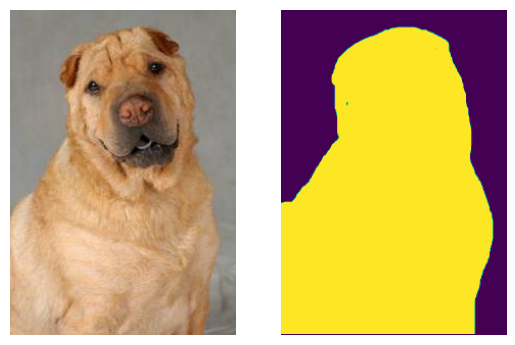

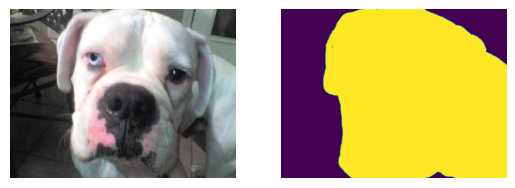

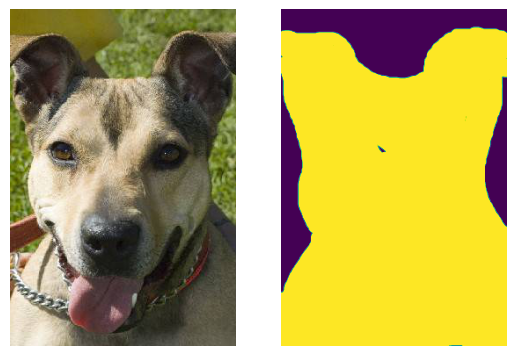

In [40]:
for n in large[:5]:
    plot(train_img_list[n], train_label_list[n])

#### Medium Sized Dog Object

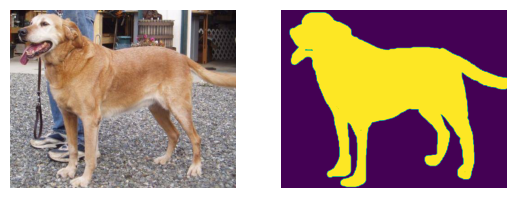

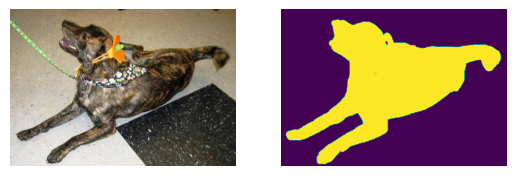

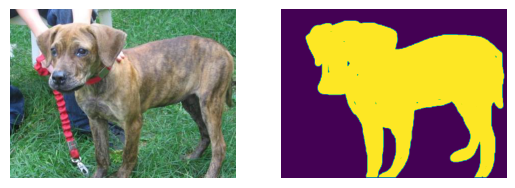

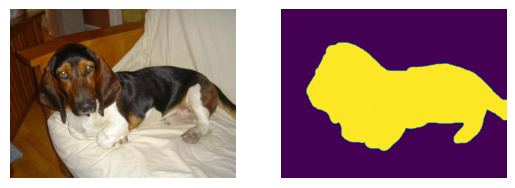

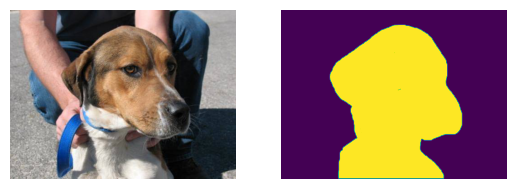

In [41]:
for n in medium[:5]:
    plot(train_img_list[n], train_label_list[n])

#### Small Sized Dog Object

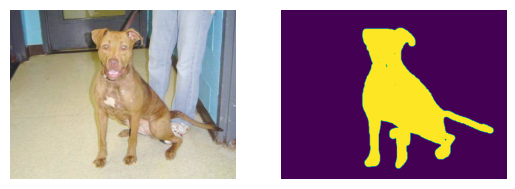

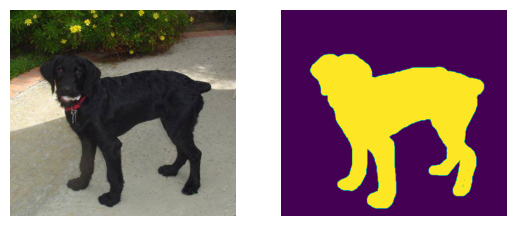

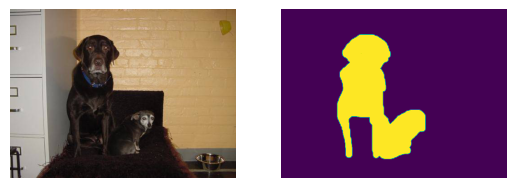

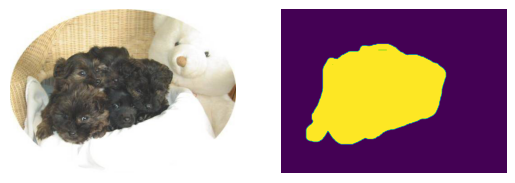

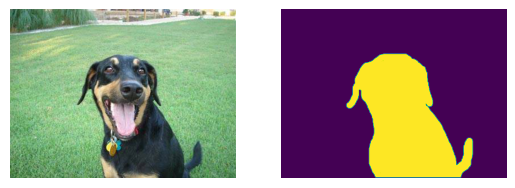

In [42]:
for n in small[:5]:
    plot(train_img_list[n], train_label_list[n])

## Data Preparation

In [49]:
model_name = 'u2net'

model_dir = os.path.join(os.getcwd(), 'saved_models', model_name)

epoch_num = 400
batch_size_train = 6
batch_size_val = 1
train_num = len(train_img_list)
val_num = len(val_img_list)


salobj_dataset = SalObjDataset(
    img_name_list=train_img_list,
    lbl_name_list=train_label_list,
    transform=transforms.Compose([
        RescaleT(320),
        RandomCrop(288),
        ToTensorLab(flag=0)]))

salobj_dataloader = DataLoader(salobj_dataset, batch_size=batch_size_train, shuffle=True, num_workers=0)

## Define Model

In [50]:
net = U2NET(3, 1)

if torch.cuda.is_available():
    net.cuda()

# define optimizer
optimizer = optim.Adam(net.parameters(), lr=0.001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0)

#define loss function
bce_loss = nn.BCELoss(size_average=True)

def muti_bce_loss_fusion(d0, d1, d2, d3, d4, d5, d6, labels_v):

	loss0 = bce_loss(d0,labels_v)
	loss1 = bce_loss(d1,labels_v)
	loss2 = bce_loss(d2,labels_v)
	loss3 = bce_loss(d3,labels_v)
	loss4 = bce_loss(d4,labels_v)
	loss5 = bce_loss(d5,labels_v)
	loss6 = bce_loss(d6,labels_v)

	loss = loss0 + loss1 + loss2 + loss3 + loss4 + loss5 + loss6
	print("l0: %3f, l1: %3f, l2: %3f, l3: %3f, l4: %3f, l5: %3f, l6: %3f\n"%(loss0.data.item(),loss1.data.item(),loss2.data.item(),loss3.data.item(),loss4.data.item(),loss5.data.item(),loss6.data.item()))

	return loss0, loss

## Train the Model

In [52]:
print("---start training...")
ite_num = 0
running_loss = 0.0
running_tar_loss = 0.0
ite_num4val = 0
save_frq = 2000 # save the model every 2000 iterations
losses = []

for epoch in range(0, epoch_num):
    net.train()

    for i, data in enumerate(salobj_dataloader):
        ite_num = ite_num + 1
        ite_num4val = ite_num4val + 1

        inputs, labels = data['image'], data['label']

        inputs = inputs.type(torch.FloatTensor)
        labels = labels.type(torch.FloatTensor)

        # wrap them in Variable
        if torch.cuda.is_available():
            inputs_v, labels_v = Variable(inputs.cuda(), requires_grad=False), Variable(labels.cuda(),
                                                                                        requires_grad=False)
        else:
            inputs_v, labels_v = Variable(inputs, requires_grad=False), Variable(labels, requires_grad=False)

        # y zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        d0, d1, d2, d3, d4, d5, d6 = net(inputs_v)
        loss2, loss = muti_bce_loss_fusion(d0, d1, d2, d3, d4, d5, d6, labels_v)

        loss.backward()
        optimizer.step()

        # # print statistics
        running_loss += loss.data.item()
        running_tar_loss += loss2.data.item()

        # del temporary outputs and loss
        del d0, d1, d2, d3, d4, d5, d6, loss2, loss

        print("[epoch: %3d/%3d, batch: %5d/%5d, ite: %d] train loss: %3f, tar: %3f " % (
        epoch + 1, epoch_num, (i + 1) * batch_size_train, train_num, ite_num, running_loss / ite_num4val, running_tar_loss / ite_num4val))

        if ite_num % save_frq == 0:

            torch.save(net.state_dict(), model_dir + model_name+"_bce_itr_%d_train_%3f_tar_%3f.pth" % (ite_num, running_loss / ite_num4val, running_tar_loss / ite_num4val))
            running_loss = 0.0
            running_tar_loss = 0.0
            net.train()  # resume train
            ite_num4val = 0

    if ite_num4val != 0:
        losses.append((epoch, (running_loss / ite_num4val)))

---start training...
l0: 0.224646, l1: 0.230970, l2: 0.259593, l3: 0.255659, l4: 0.249331, l5: 0.254805, l6: 0.271764

[epoch:   1/400, batch:     6/  125, ite: 1] train loss: 1.746767, tar: 0.224646 
l0: 0.199174, l1: 0.221916, l2: 0.198871, l3: 0.195505, l4: 0.211860, l5: 0.217755, l6: 0.236491

[epoch:   1/400, batch:    12/  125, ite: 2] train loss: 1.614169, tar: 0.211910 
l0: 0.127873, l1: 0.139007, l2: 0.155111, l3: 0.147392, l4: 0.141613, l5: 0.140358, l6: 0.159959

[epoch:   1/400, batch:    18/  125, ite: 3] train loss: 1.413218, tar: 0.183898 
l0: 0.166362, l1: 0.171029, l2: 0.195388, l3: 0.189254, l4: 0.181531, l5: 0.177609, l6: 0.195166

[epoch:   1/400, batch:    24/  125, ite: 4] train loss: 1.378998, tar: 0.179514 
l0: 0.143823, l1: 0.146062, l2: 0.158470, l3: 0.162477, l4: 0.174931, l5: 0.193871, l6: 0.216859

[epoch:   1/400, batch:    30/  125, ite: 5] train loss: 1.342497, tar: 0.172376 
l0: 0.197975, l1: 0.206380, l2: 0.227868, l3: 0.222366, l4: 0.219997, l5: 0.219

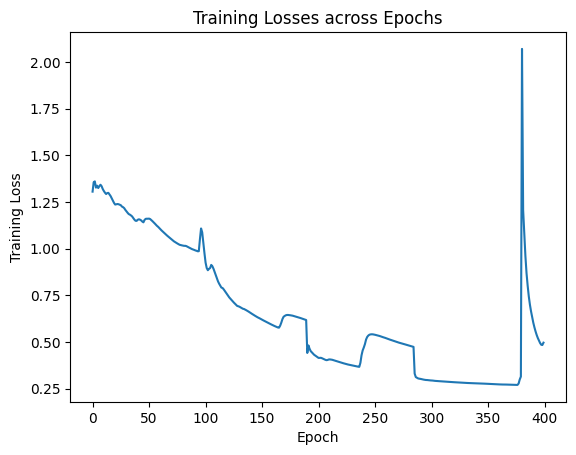

In [54]:
epoch_arr = np.array([x[0] for x in losses])
loss_arr = np.array([x[1] for x in losses])

plt.plot(epoch_arr, loss_arr)

plt.xlabel('Epoch')
plt.ylabel('Training Loss')
plt.title('Training Losses across Epochs')

plt.show()


- For the model training, I chose <b>Adam optimizer</b> and <b>muti_bce_loss_fusion</b>, which computes binary cross entropy loss for each prediction made at different stages of U2-Net and then sum up the losses.
- I trained the model for <b>400</b> epochs with batch size of <b>6</b>
- According to the trace of the training loss, the longer the training steps, the smaller the training loss until 380 epochs.
- We should not train the model for more iterations to avoid overfitting the training data.

## Some Helper Functions

In [55]:
def predict(image, model_dir):
    image, org_image = load_image(image)
    mask, image = get_output_and_mask(image, org_image, model_dir)

    return mask, image

def get_output_and_mask(image, org_image, model_dir):
    net = U2NET(3,1)

    if torch.cuda.is_available():
        net.load_state_dict(torch.load(model_dir))
        net.cuda()
    else:
        net.load_state_dict(torch.load(model_dir, map_location='cpu'))
    net.eval()

    image = image.type(torch.FloatTensor)
    if torch.cuda.is_available():
        image = Variable(image.cuda())
    else:
        image = Variable(image)
        
    mask, d2, d3, d4, d5, d6, d7 = net(image)

    # Normalization
    mask = mask[:, 0, :, :]
    mask = normalize(mask)
    # Prepare mask
    mask = prepare_mask(mask, org_image.size)
    # Apply mask to image
    empty = Image.new('RGBA', org_image.size)
    image = Image.composite(org_image, empty, mask)
    return mask, image

def ndarray2tensor(image: np.ndarray):
    """
    Converts a Numpy array to a tensor
    Inputs:
        Image numpy array
    Returns:
        Image tensor
    """
    tmp_img = np.zeros((image.shape[0], image.shape[1], 3))
    image /= np.max(image)
    if image.shape[2] == 1:
        tmp_img[:, :, 0] = (image[:, :, 0] - 0.485) / 0.229
        tmp_img[:, :, 1] = (image[:, :, 0] - 0.485) / 0.229
        tmp_img[:, :, 2] = (image[:, :, 0] - 0.485) / 0.229
    else:
        tmp_img[:, :, 0] = (image[:, :, 0] - 0.485) / 0.229
        tmp_img[:, :, 1] = (image[:, :, 1] - 0.456) / 0.224
        tmp_img[:, :, 2] = (image[:, :, 2] - 0.406) / 0.225
    tmp_img = tmp_img.transpose((2, 0, 1))
    tmp_img = np.expand_dims(tmp_img, 0)
    return torch.from_numpy(tmp_img)
    
def load_image(image):
    image_size = 320

    pil_image = image
    image = np.array(image)
    image = transform.resize(image, (image_size, image_size), mode='constant')
    image = ndarray2tensor(image)
    return image, pil_image


def normalize(predicted):
    ma = torch.max(predicted)
    mi = torch.min(predicted)
    out = (predicted - mi) / (ma - mi)
    return out
    
def prepare_mask(predict, image_size):
    predict = predict.squeeze()
    predict_np = predict.cpu().data.numpy()
    mask = Image.fromarray(predict_np * 255).convert("L")
    mask = mask.resize(image_size, resample=Image.BILINEAR)
    return mask

## Evaluate the performance of the model using IoU score and Recall
- The main goal is just to focus about positive predictions whether the model segments dog or not.
- I used IoU score (Intersection over Union) to calculate the intersection of predicted mask and ground truth mask.
- Recall = TP / TP + FN, in this case, we will consider IoU score > threshold -> true positive to increment to 1, otherwise false positive to 1.
- IoU score (Intersection over Union), is a metric used in object detection that measures the overlap between two bounding boxes, specifically, the area of overlap divided by the area of union, to assess the accuracy of a predicted bounding box in relation to the true box.

In [62]:
model_name = 'u2net'

model_dir = os.path.join(os.getcwd(), 'saved_models/u2netu2net_bce_itr_6000_train_0.472736_tar_0.054795.pth')

img_name_list = train_img_list.copy()

Dog_Segmentation/Images/dog.8900.jpg


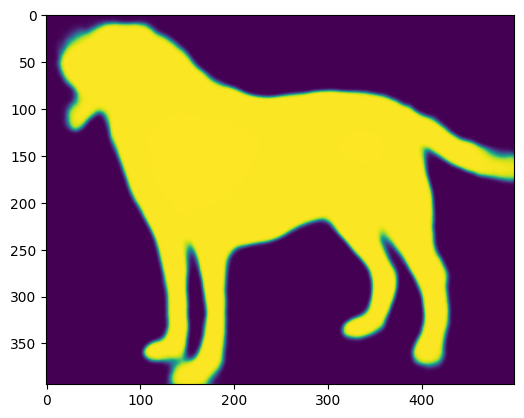

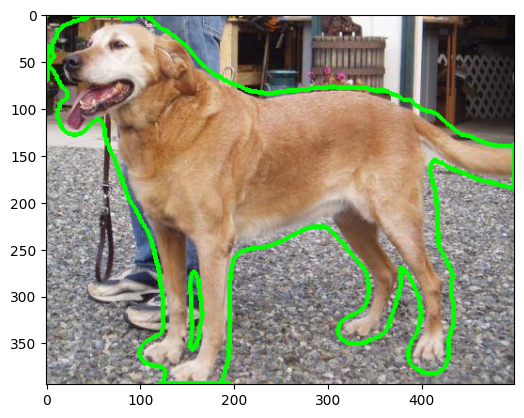

Dog_Segmentation/Images/dog.8891.jpg


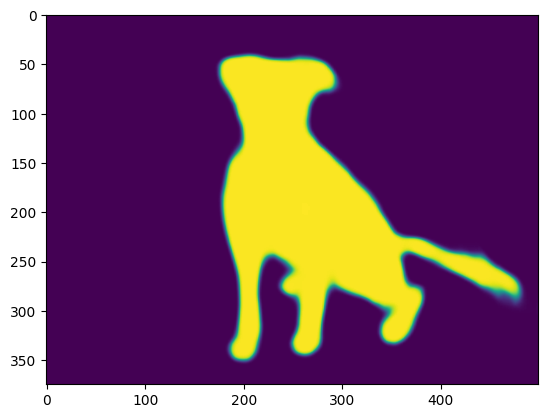

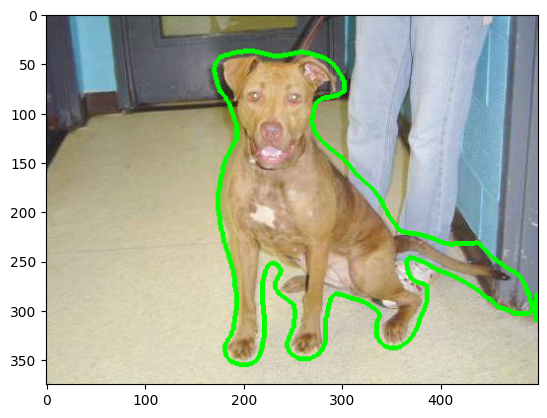

Dog_Segmentation/Images/dog.8950.jpg


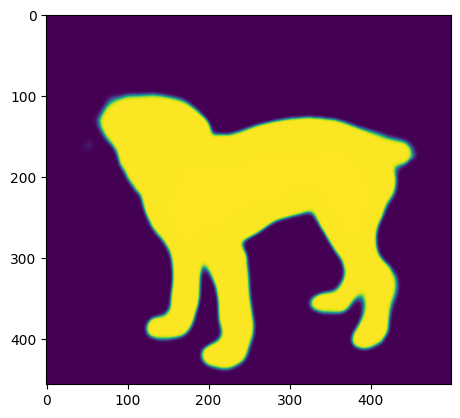

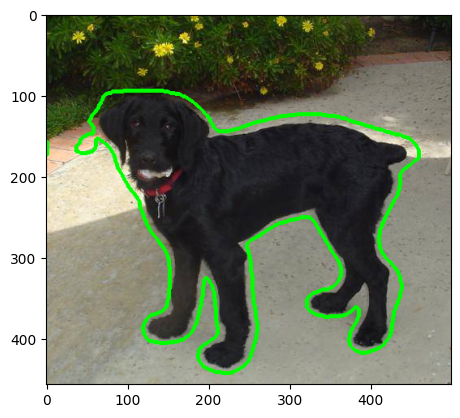

Dog_Segmentation/Images/dog.8816.jpg


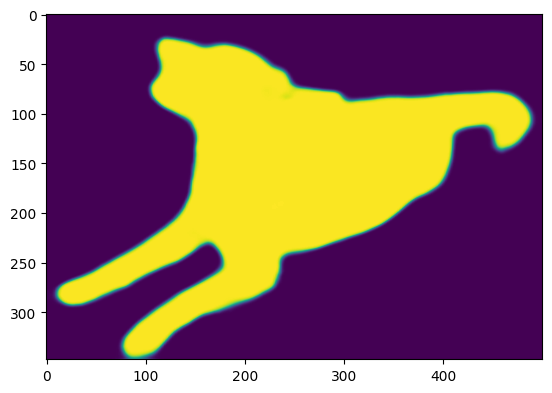

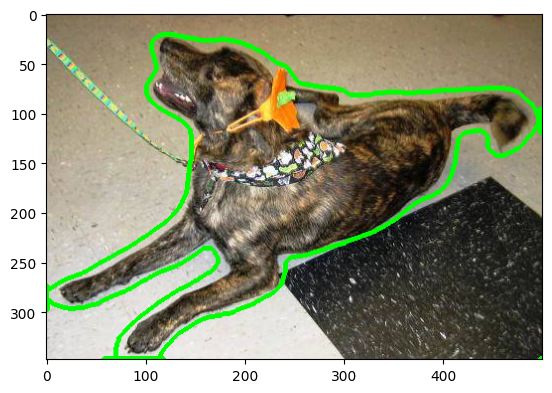

Dog_Segmentation/Images/dog.8789.jpg


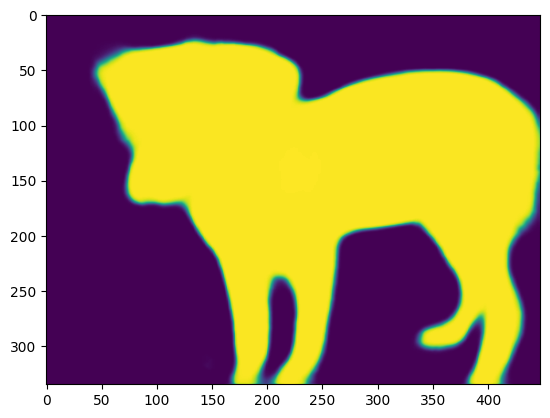

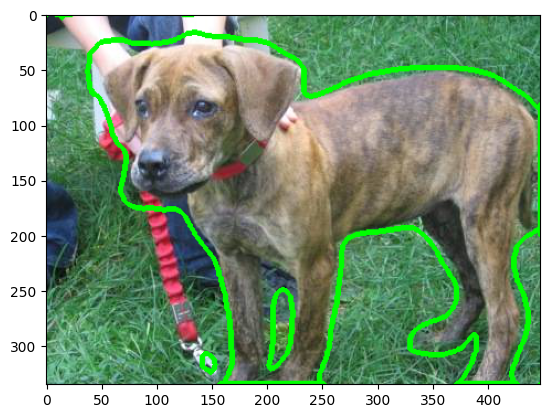

Dog_Segmentation/Images/dog.8815.jpg


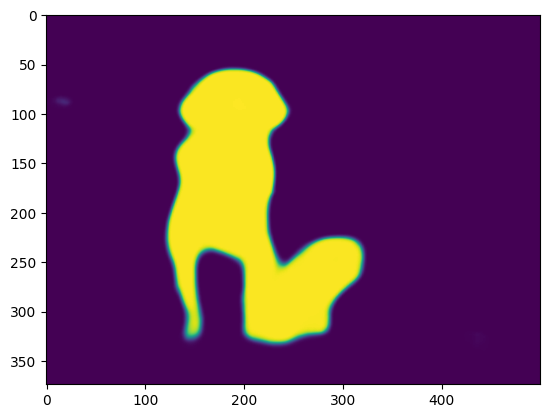

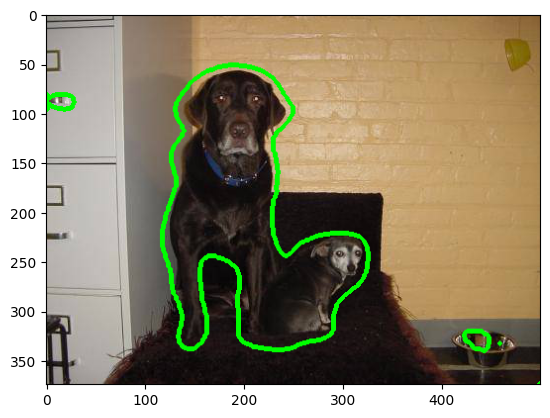

Dog_Segmentation/Images/dog.8792.jpg


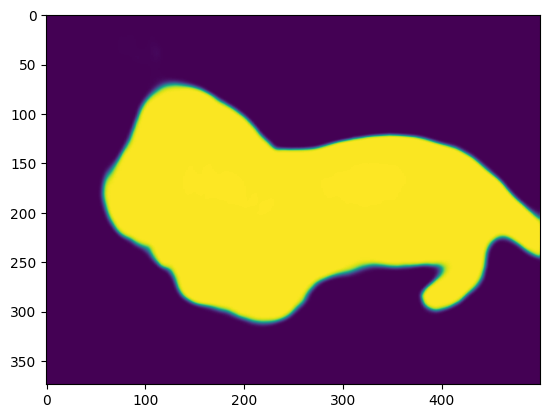

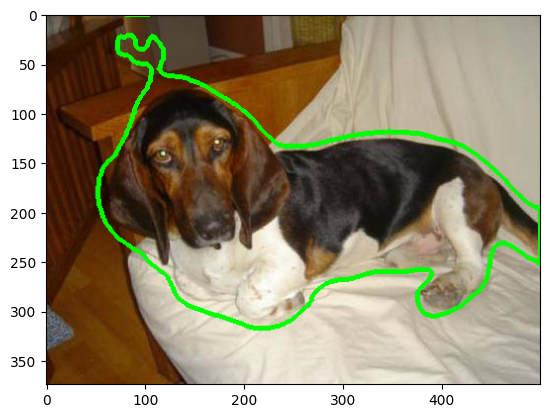

Dog_Segmentation/Images/dog.8840.jpg


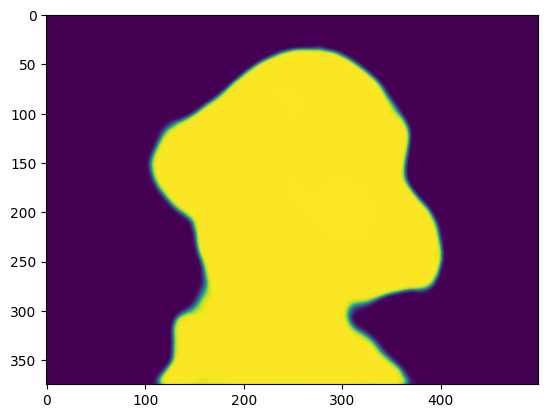

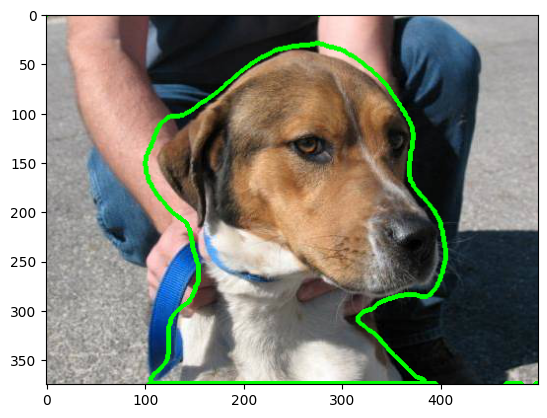

Dog_Segmentation/Images/dog.8917.jpg


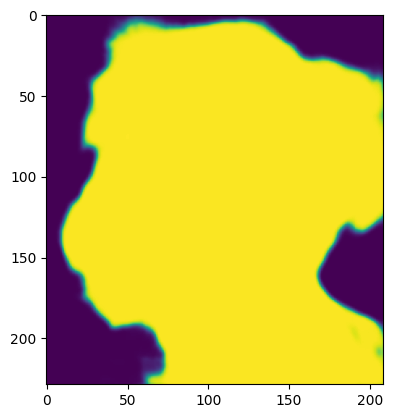

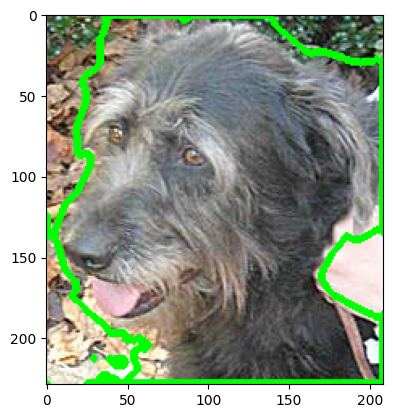

Dog_Segmentation/Images/dog.8927.jpg


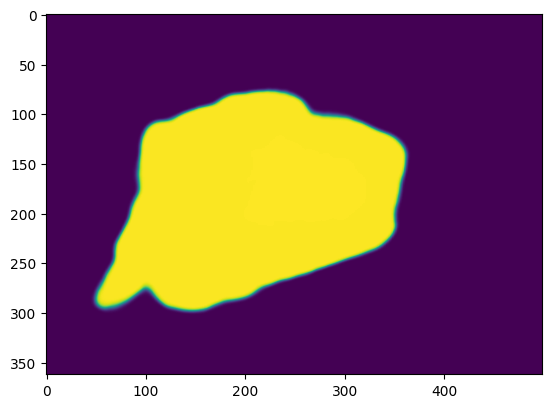

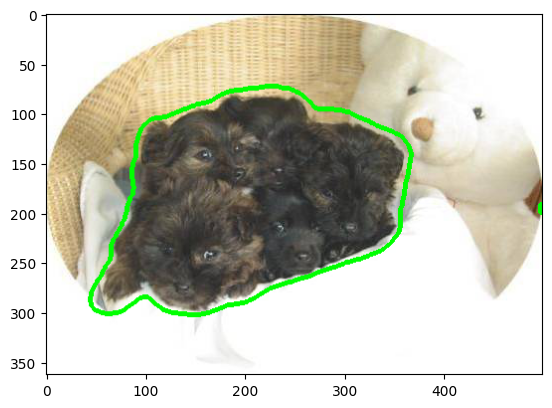

In [63]:
for img in train_img_list[:10]:
    print(img)
    ori = Image.open(img)
    np_image = np.array(ori)
    mask, image = predict(ori, model_dir)
    plt.imshow(np.array(mask))
    plt.show()
    
    contours, hierarchy = cv2.findContours(np.array(mask), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    cv2.drawContours(np_image, contours, -1, (0,255,0), 3)
    plt.imshow(np_image)
    plt.show()

Dog_Segmentation/Images/dog.8870.jpg


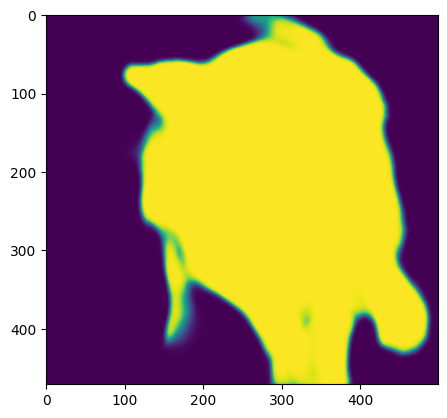

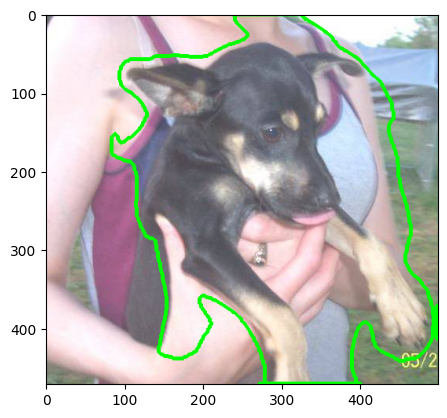

Dog_Segmentation/Images/dog.8802.jpg


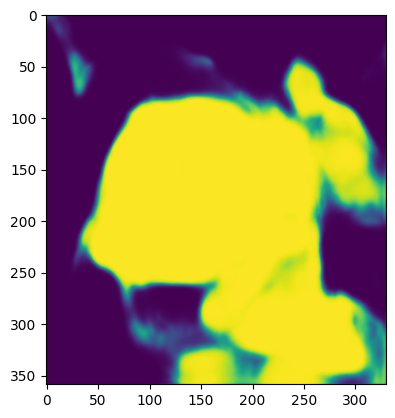

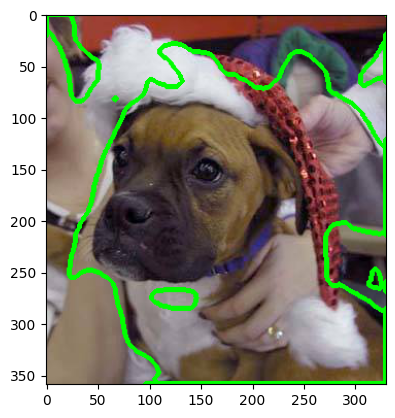

Dog_Segmentation/Images/dog.8925.jpg


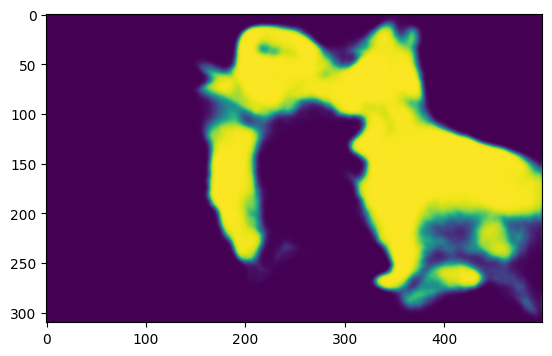

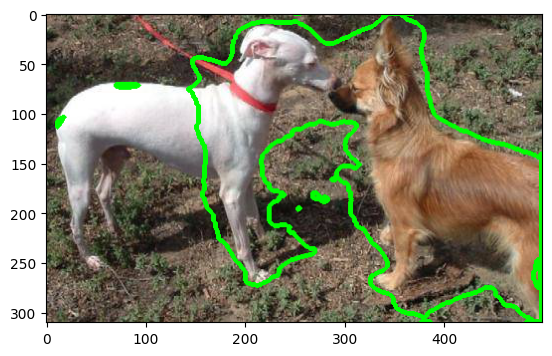

Dog_Segmentation/Images/dog.8956.jpg


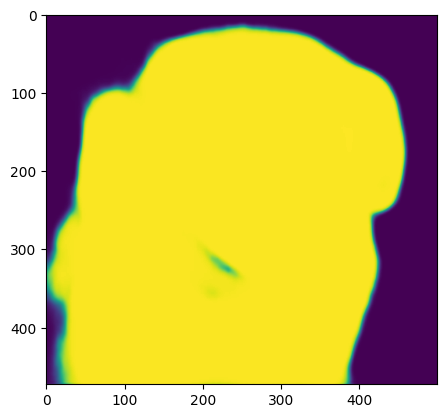

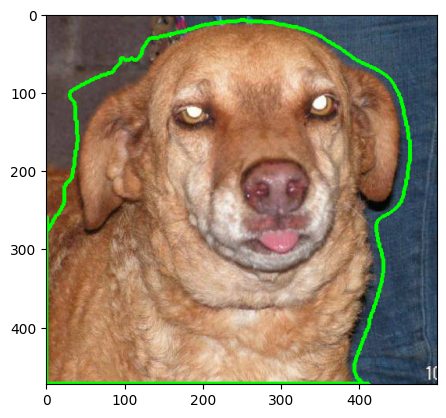

Dog_Segmentation/Images/dog.8800.jpg


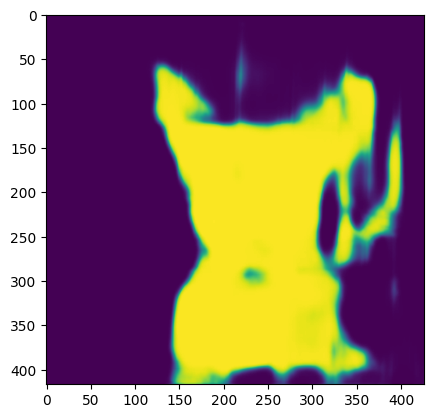

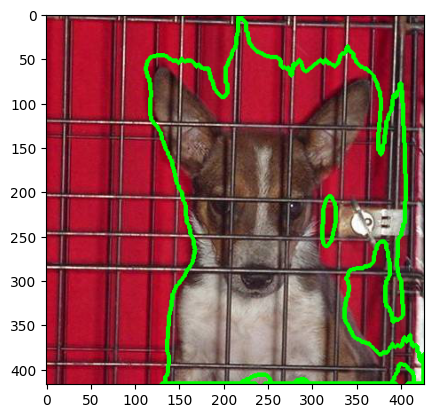

Dog_Segmentation/Images/dog.8965.jpg


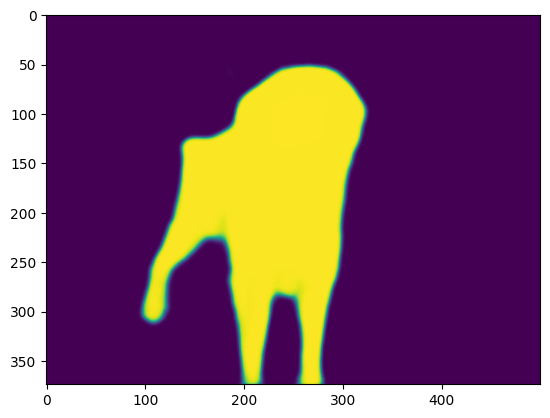

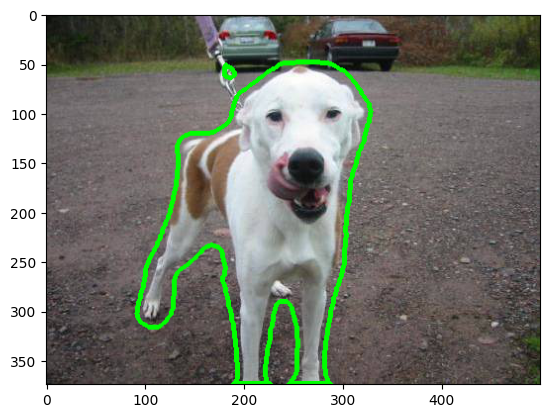

Dog_Segmentation/Images/dog.8836.jpg


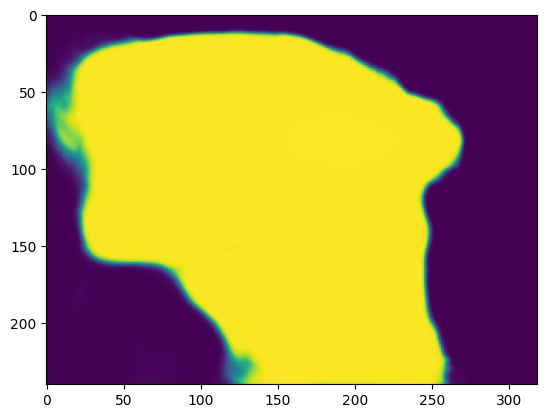

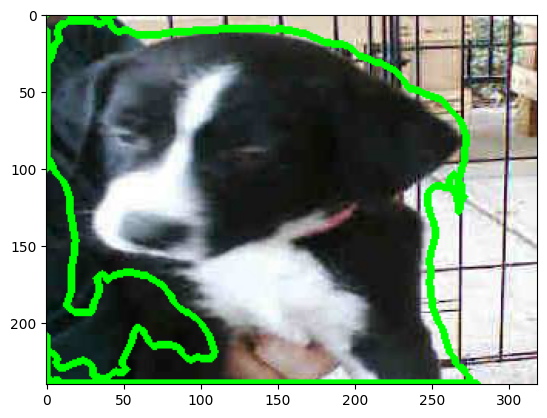

Dog_Segmentation/Images/dog.8837.jpg


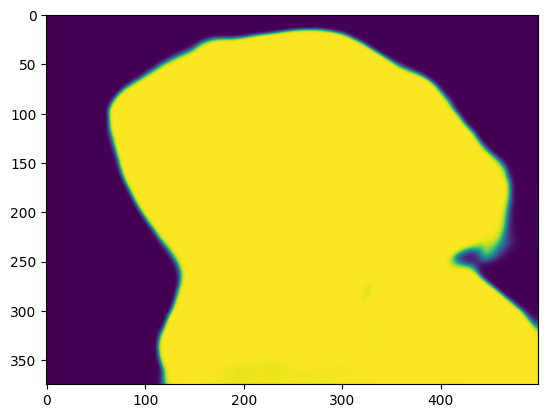

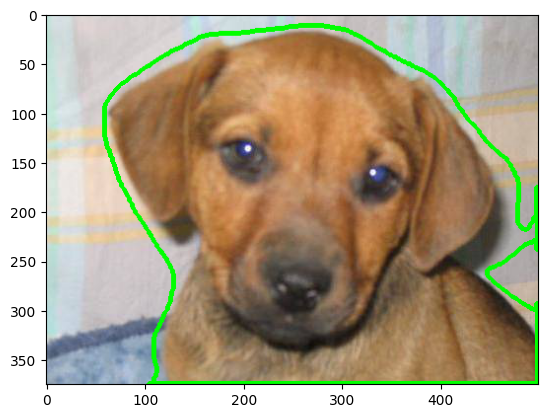

Dog_Segmentation/Images/dog.8812.jpg


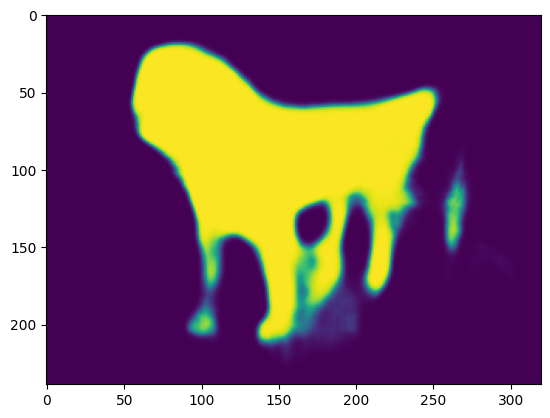

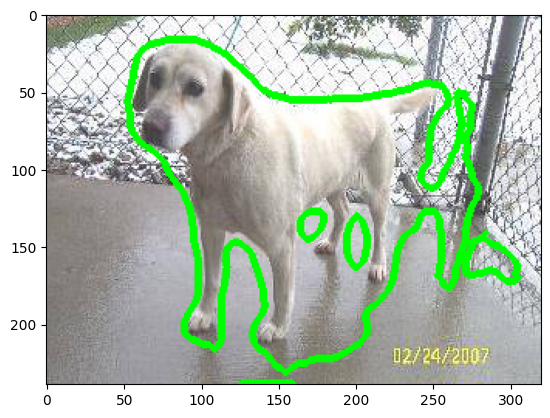

Dog_Segmentation/Images/dog.8931.jpg


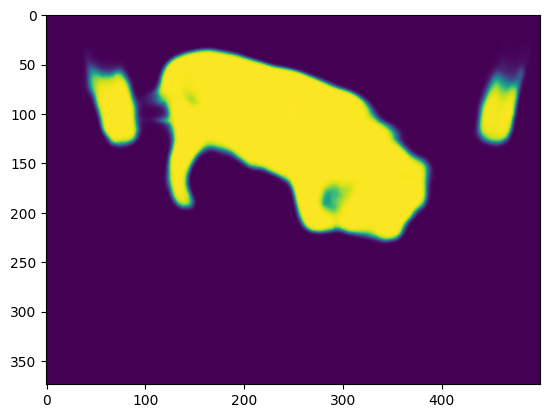

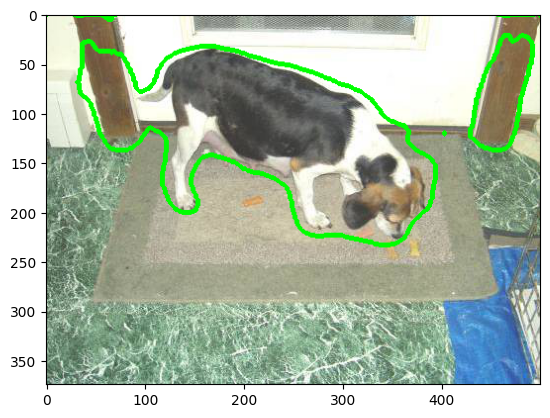

Dog_Segmentation/Images/dog.8856.jpg


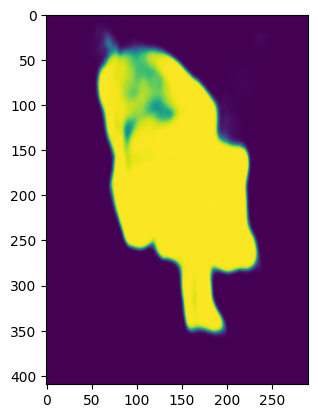

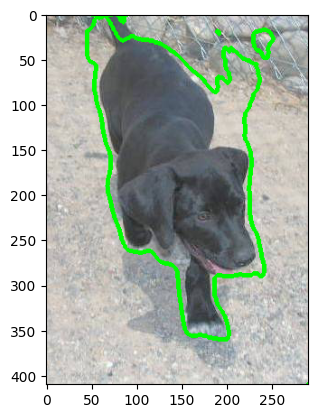

Dog_Segmentation/Images/dog.8903.jpg


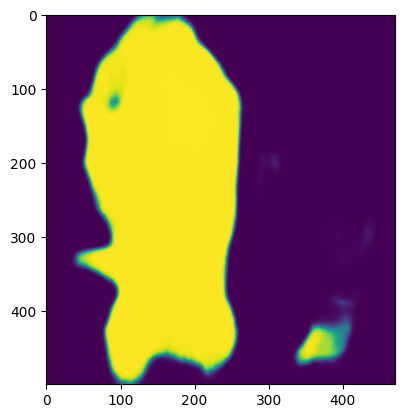

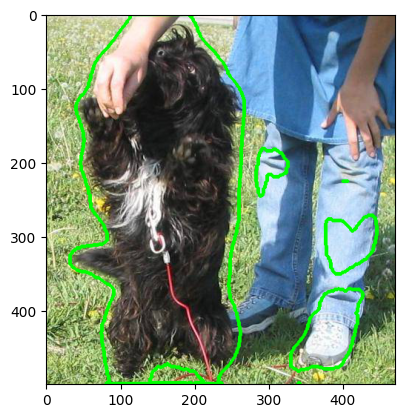

Dog_Segmentation/Images/dog.8865.jpg


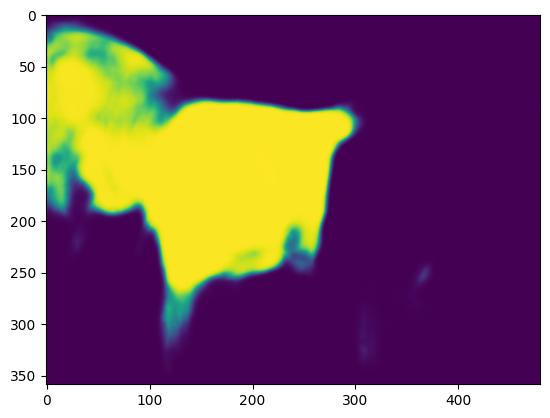

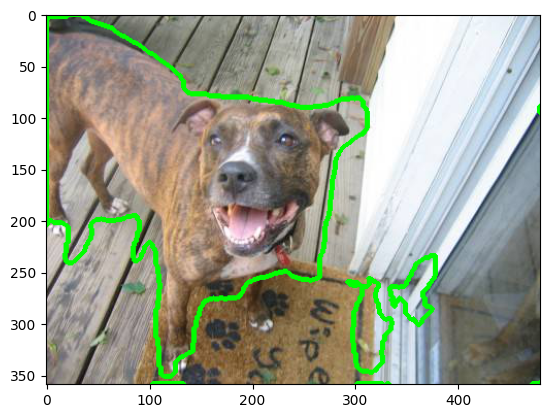

Dog_Segmentation/Images/dog.8913.jpg


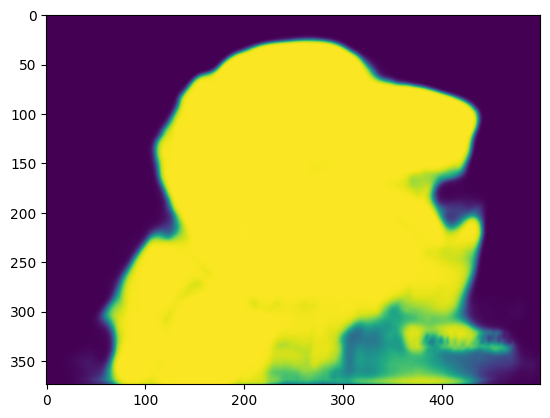

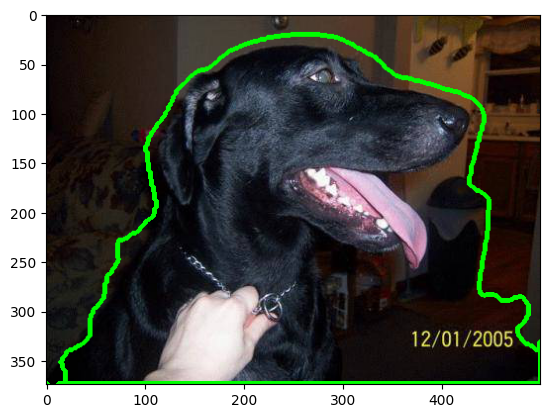

Dog_Segmentation/Images/dog.8962.jpg


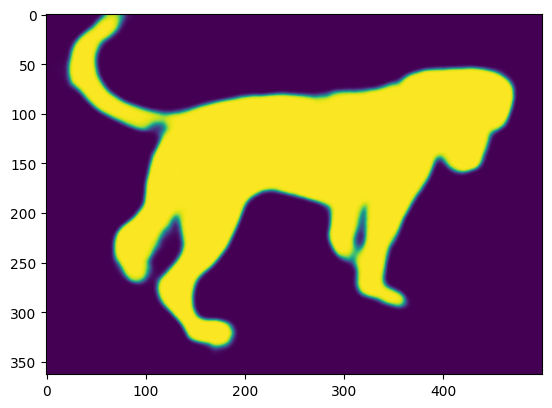

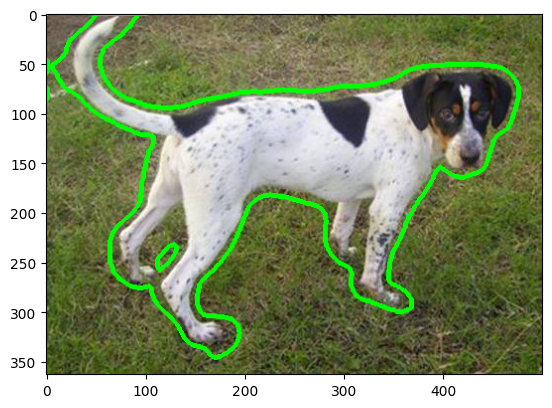

Dog_Segmentation/Images/dog.8939.jpg


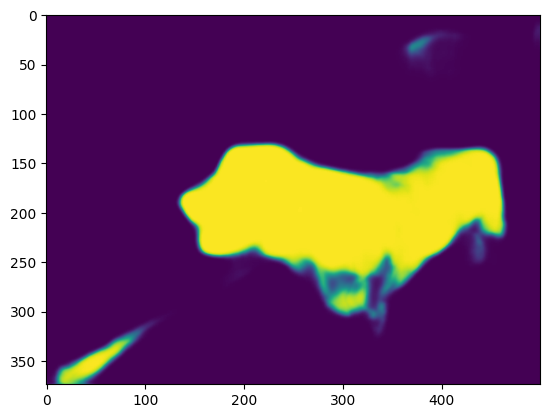

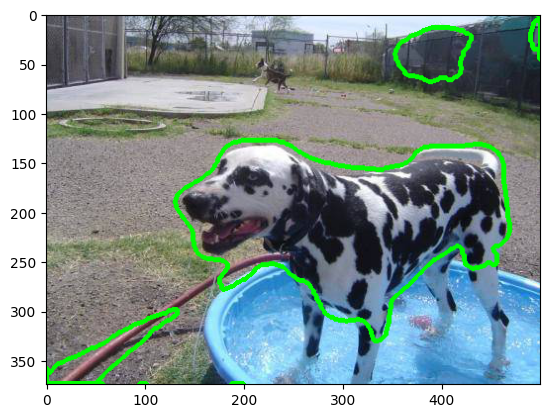

Dog_Segmentation/Images/dog.8866.jpg


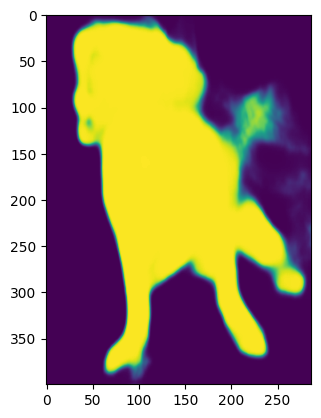

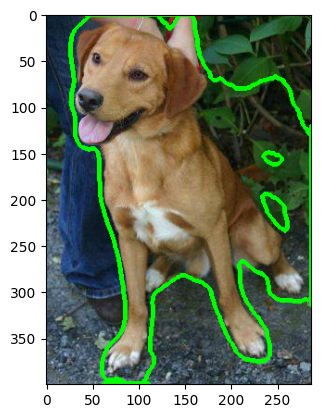

Dog_Segmentation/Images/dog.8928.jpg


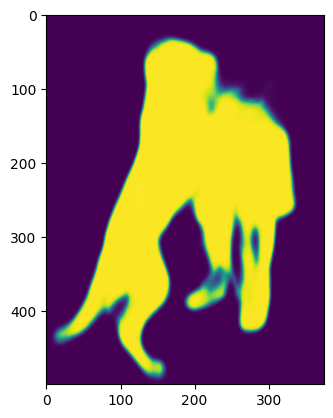

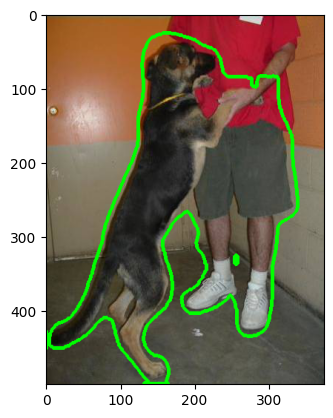

Dog_Segmentation/Images/dog.8809.jpg


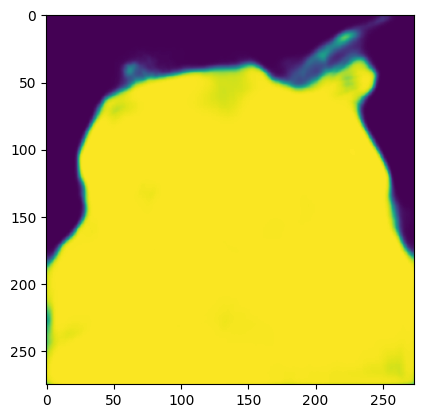

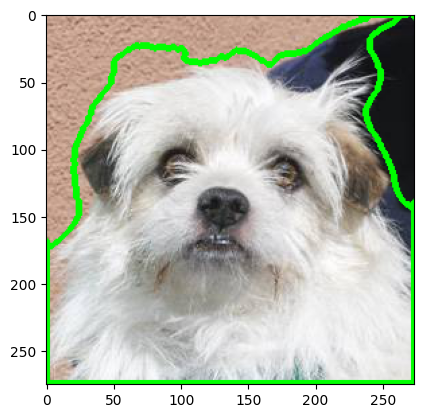

Dog_Segmentation/Images/dog.8943.jpg


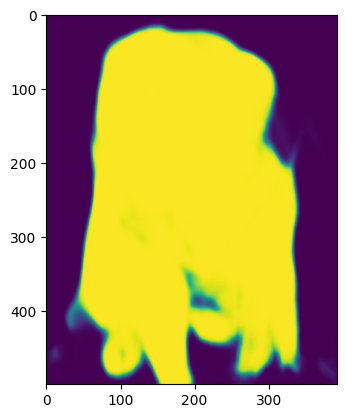

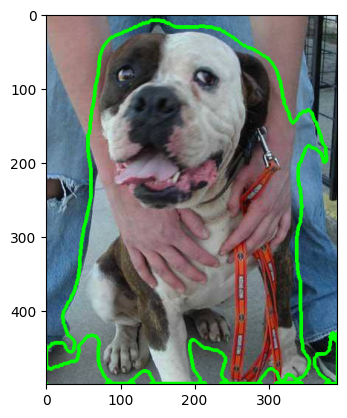

Dog_Segmentation/Images/dog.8796.jpg


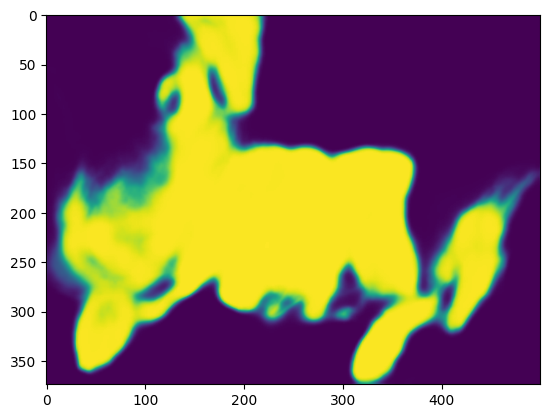

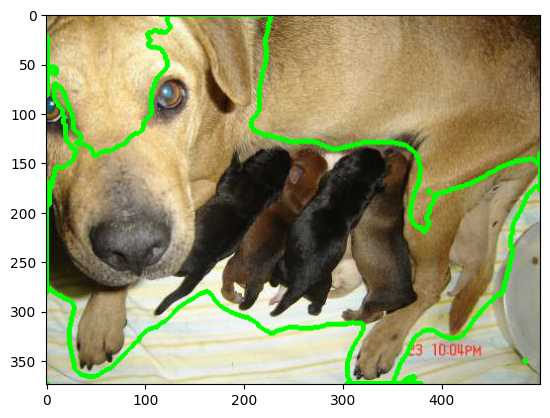

Dog_Segmentation/Images/dog.8852.jpg


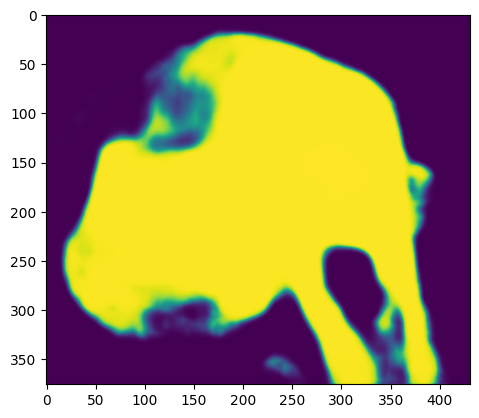

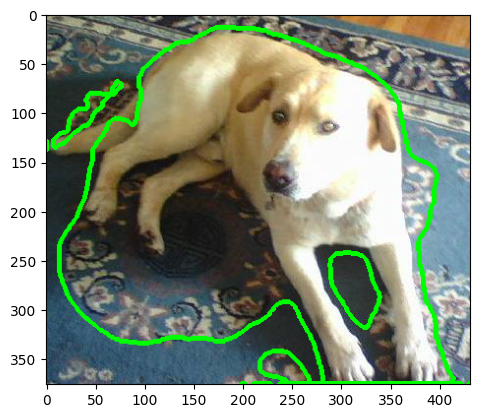

Dog_Segmentation/Images/dog.8963.jpg


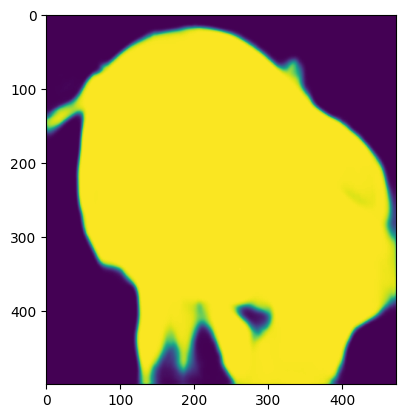

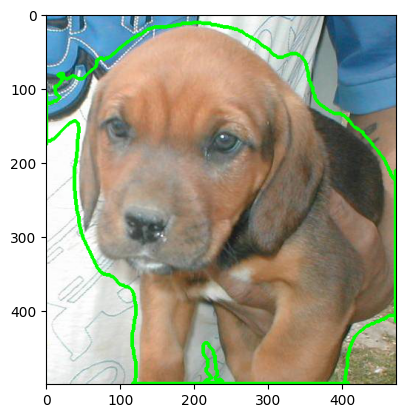

Dog_Segmentation/Images/dog.8929.jpg


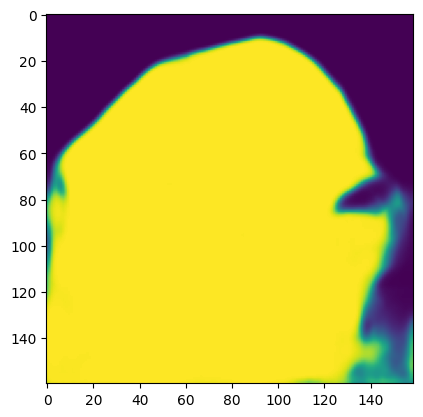

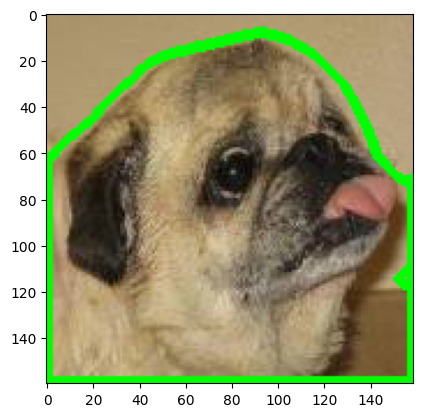

Dog_Segmentation/Images/dog.8824.jpg


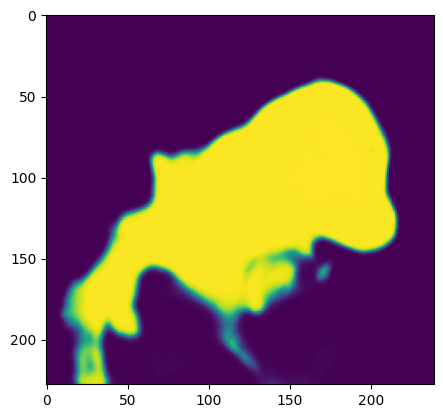

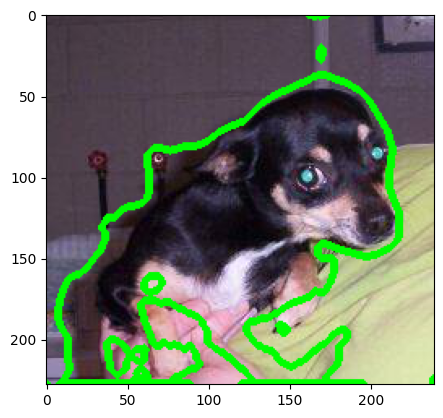

Dog_Segmentation/Images/dog.8788.jpg


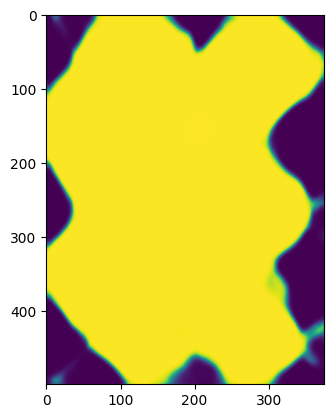

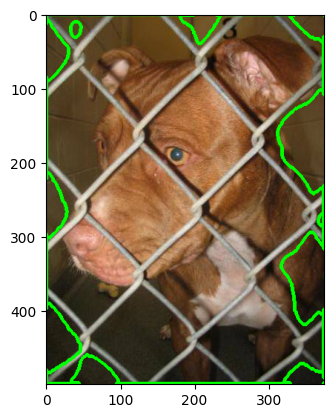

Dog_Segmentation/Images/dog.8860.jpg


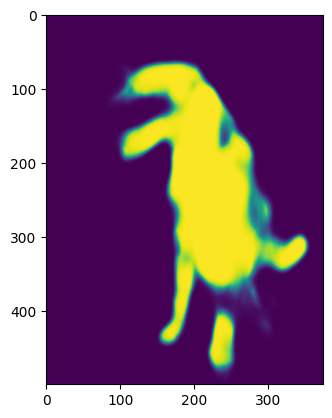

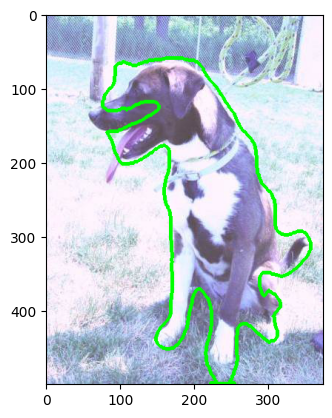

Dog_Segmentation/Images/dog.8878.jpg


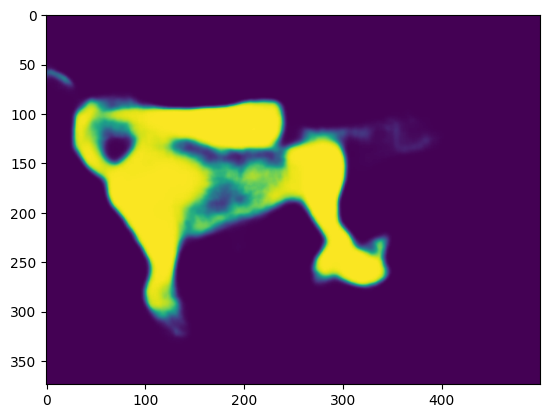

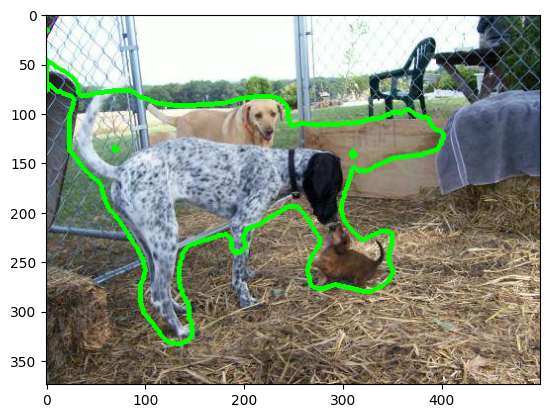

Dog_Segmentation/Images/dog.8863.jpg


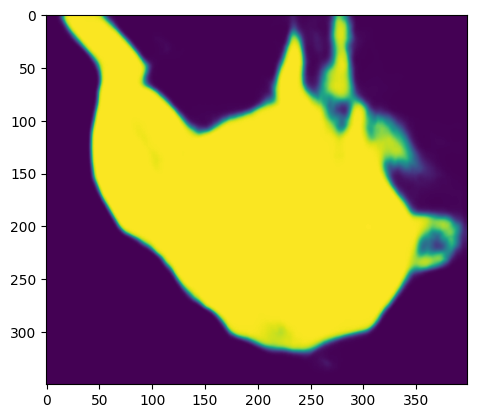

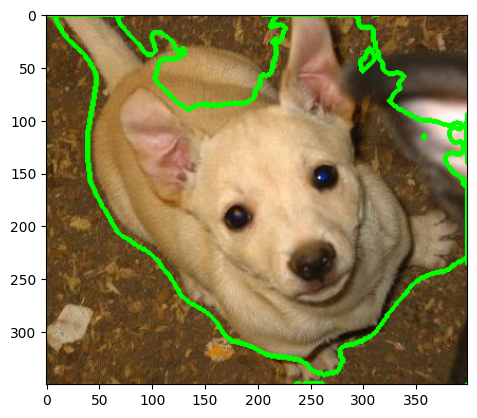

Dog_Segmentation/Images/dog.8945.jpg


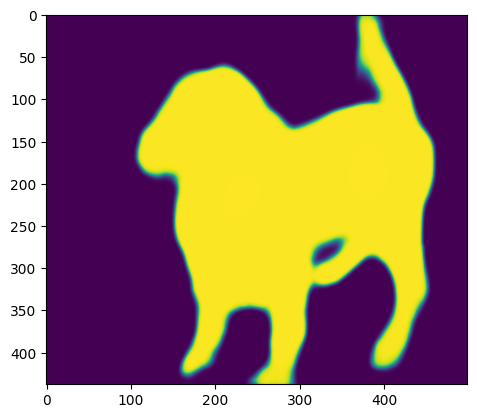

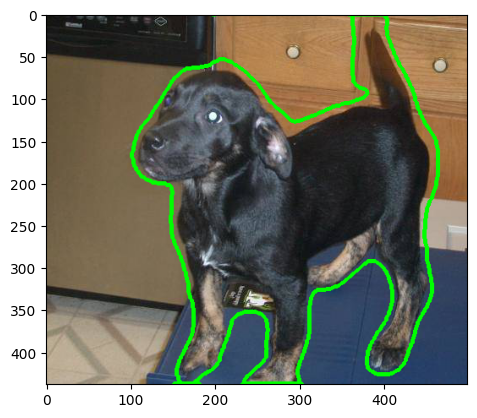

Dog_Segmentation/Images/dog.8899.jpg


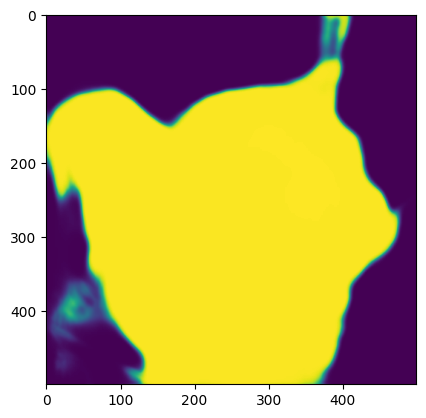

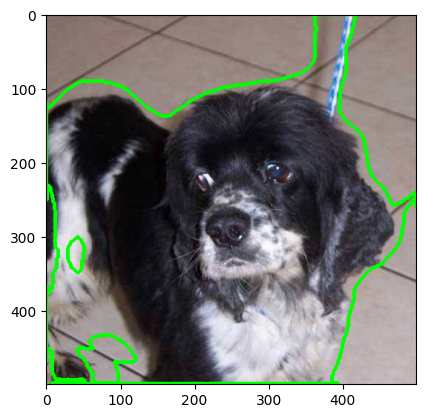

Dog_Segmentation/Images/dog.8811.jpg


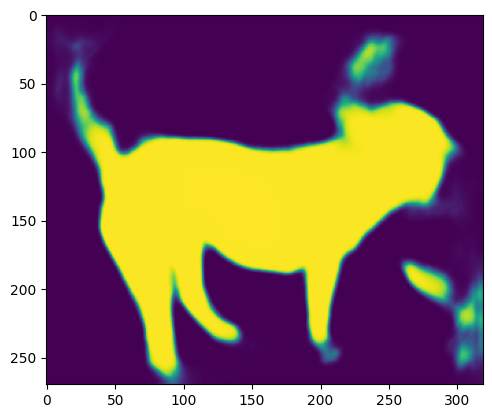

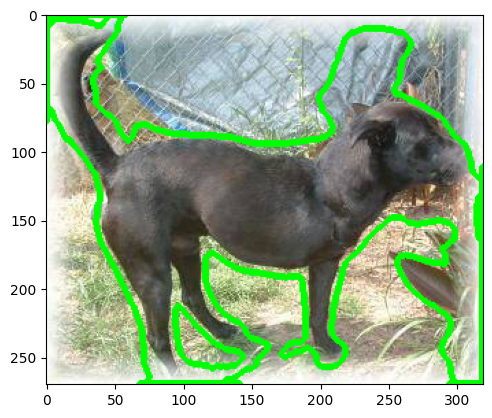

Dog_Segmentation/Images/dog.8861.jpg


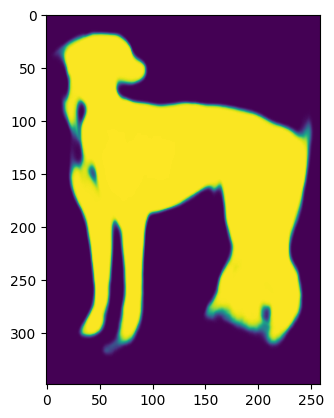

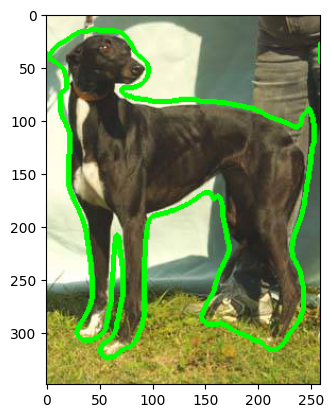

Dog_Segmentation/Images/dog.8883.jpg


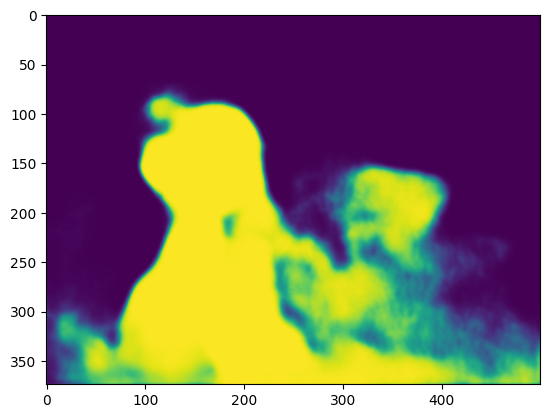

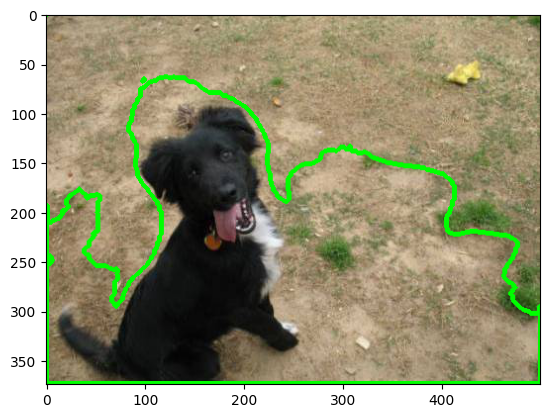

Dog_Segmentation/Images/dog.8957.jpg


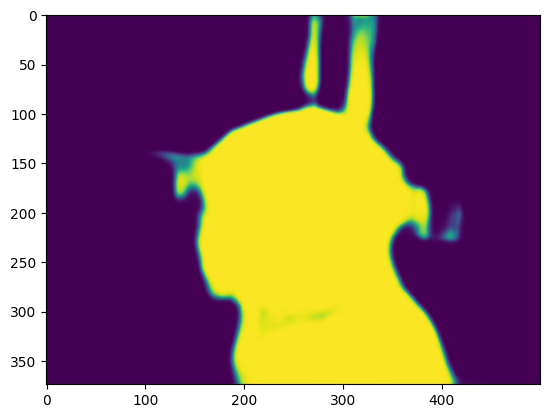

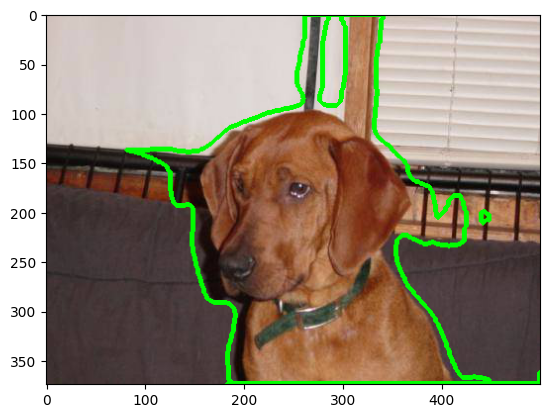

Dog_Segmentation/Images/dog.8823.jpg


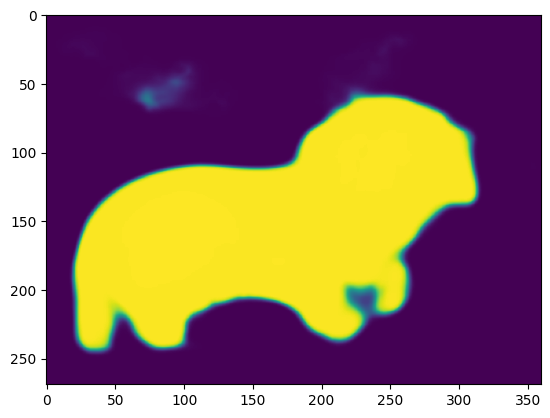

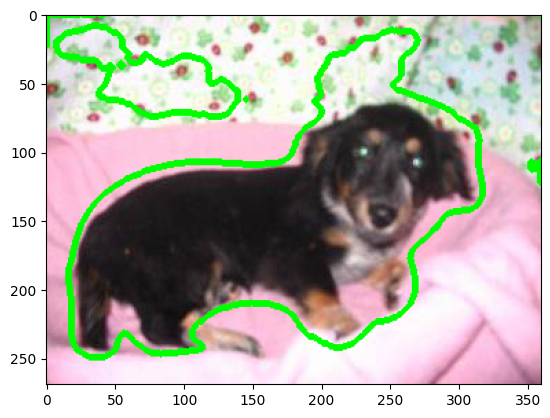

Dog_Segmentation/Images/dog.8884.jpg


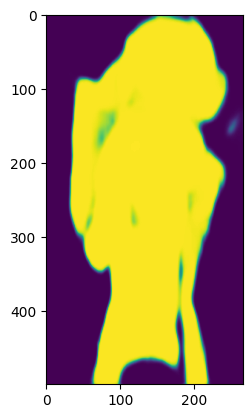

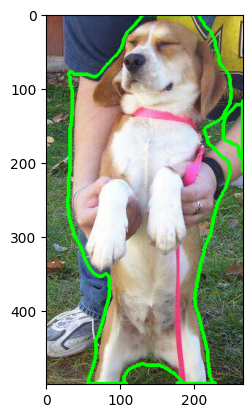

Dog_Segmentation/Images/dog.8954.jpg


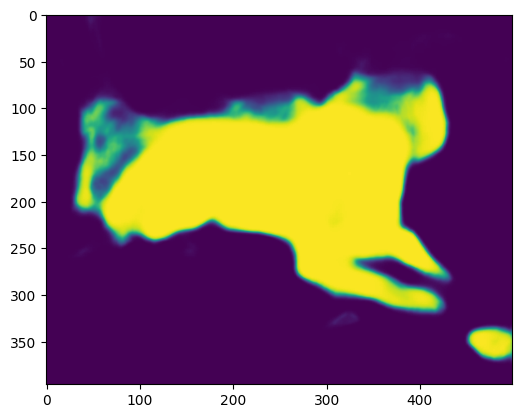

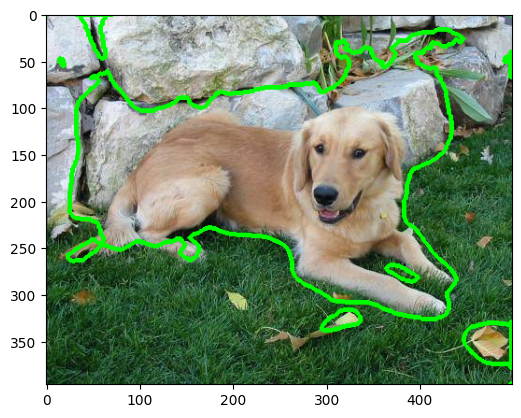

Dog_Segmentation/Images/dog.8804.jpg


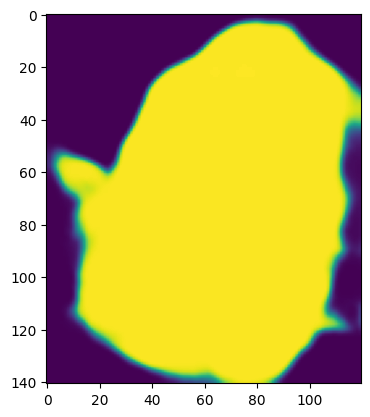

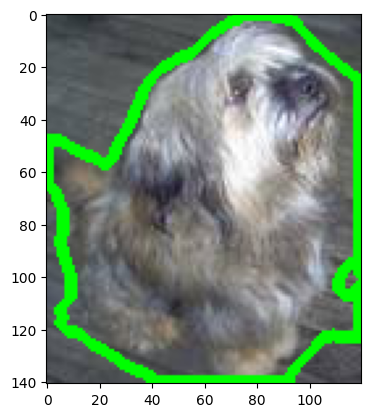

Dog_Segmentation/Images/dog.8795.jpg


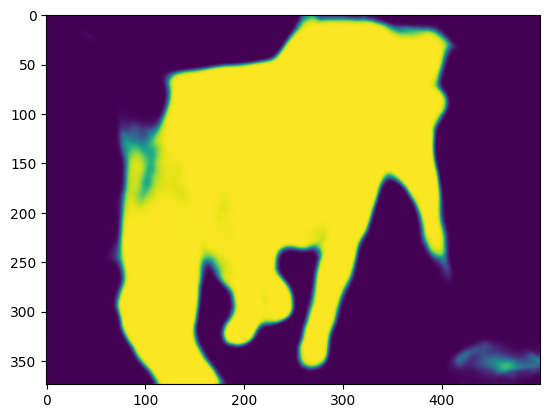

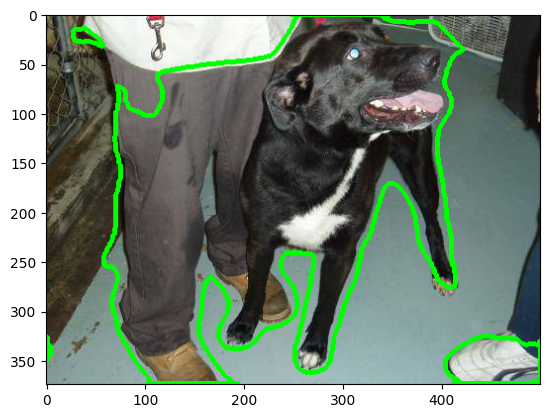

Dog_Segmentation/Images/dog.8835.jpg


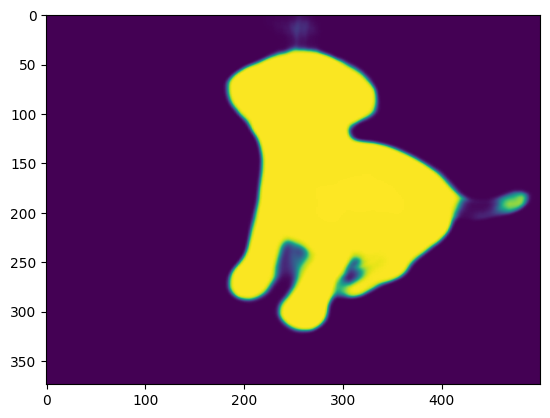

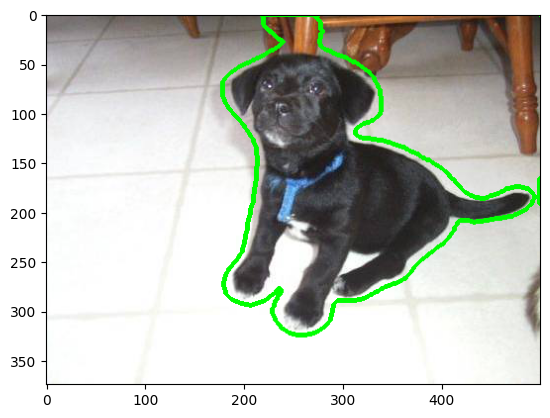

Dog_Segmentation/Images/dog.8821.jpg


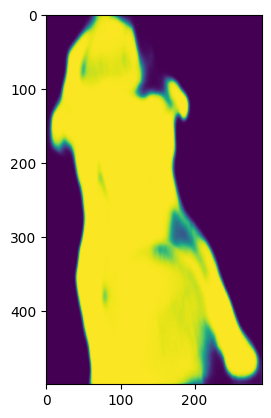

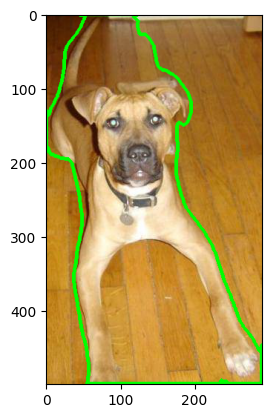

Dog_Segmentation/Images/dog.8805.jpg


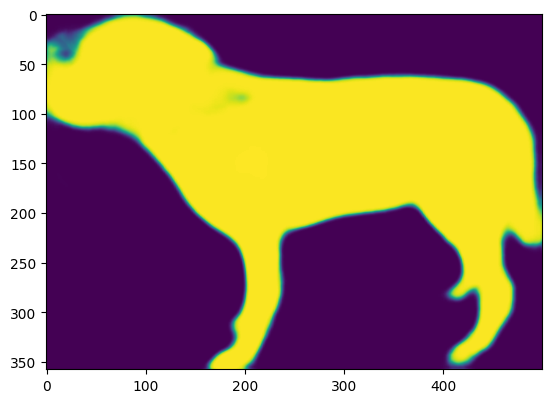

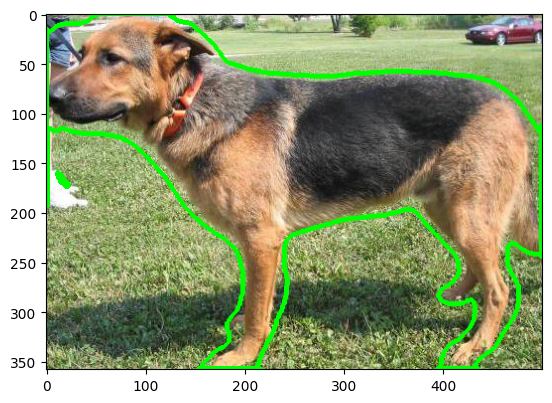

Dog_Segmentation/Images/dog.8877.jpg


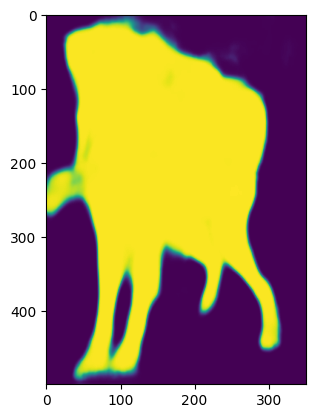

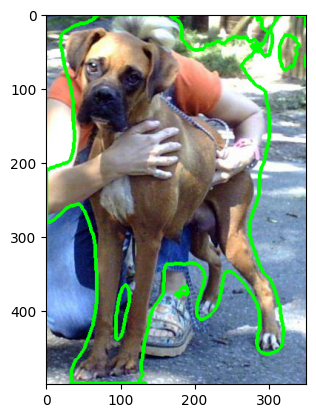

Dog_Segmentation/Images/dog.8923.jpg


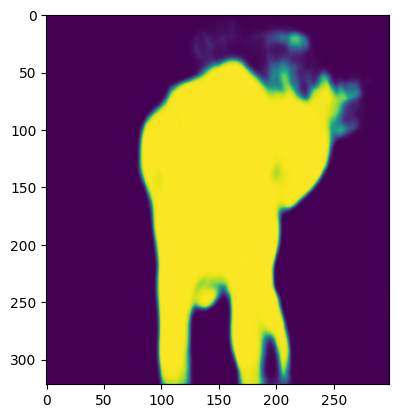

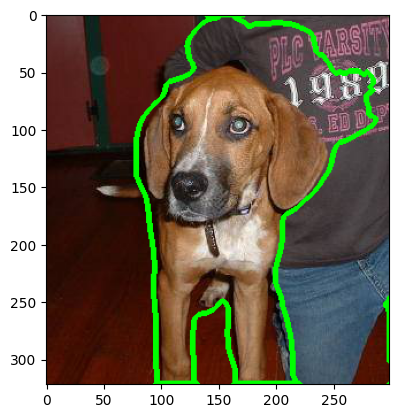

Dog_Segmentation/Images/dog.8879.jpg


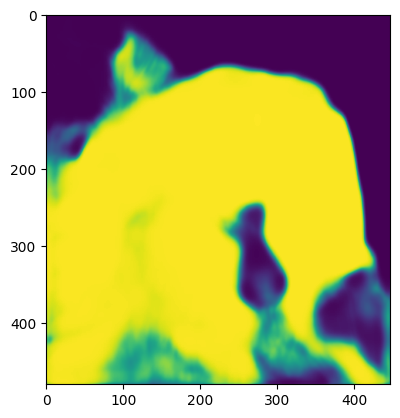

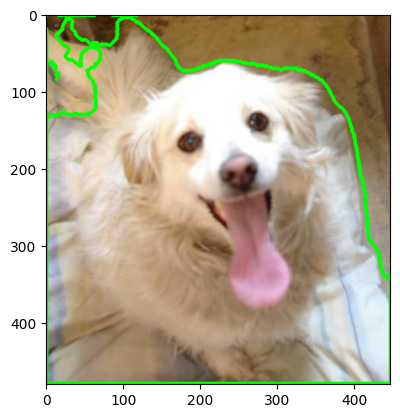

Dog_Segmentation/Images/dog.8850.jpg


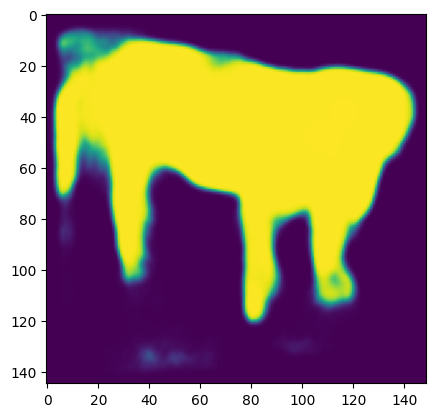

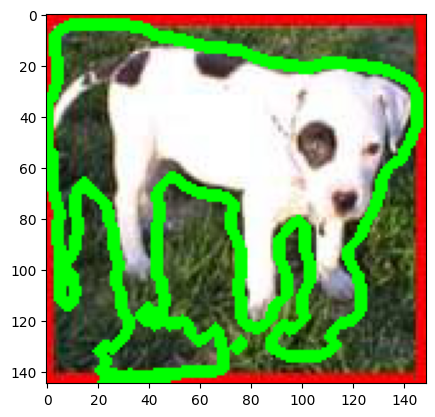

Dog_Segmentation/Images/dog.8841.jpg


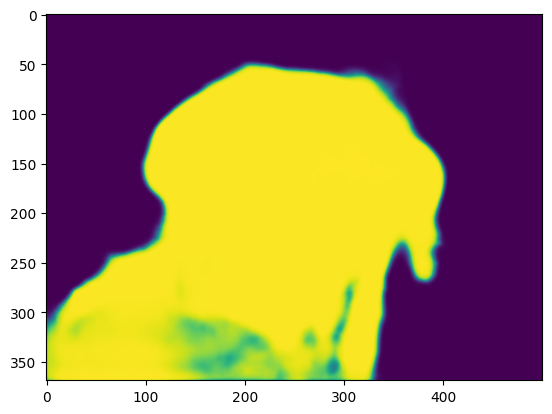

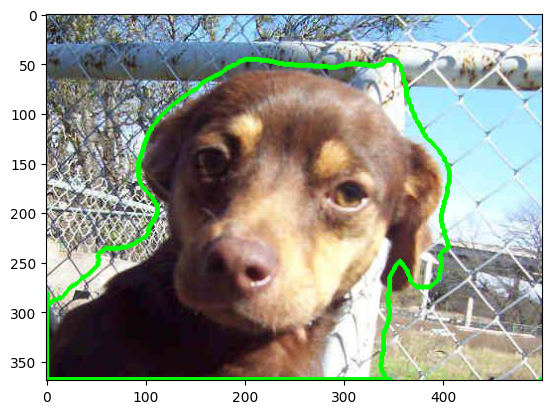

Dog_Segmentation/Images/dog.8936.jpg


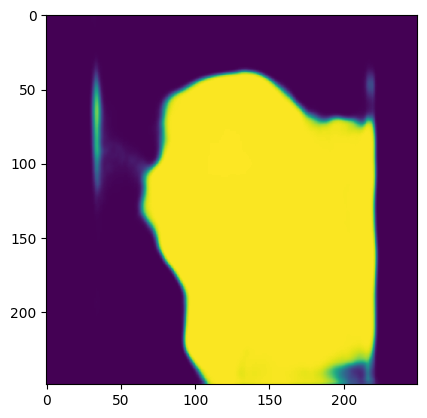

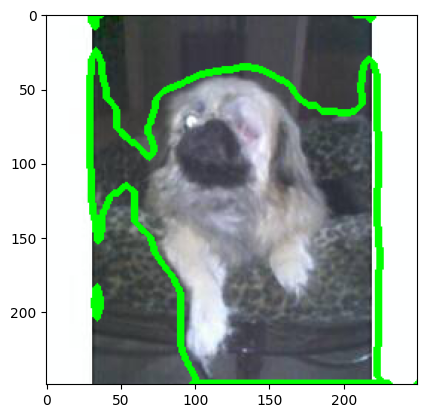

Dog_Segmentation/Images/dog.8793.jpg


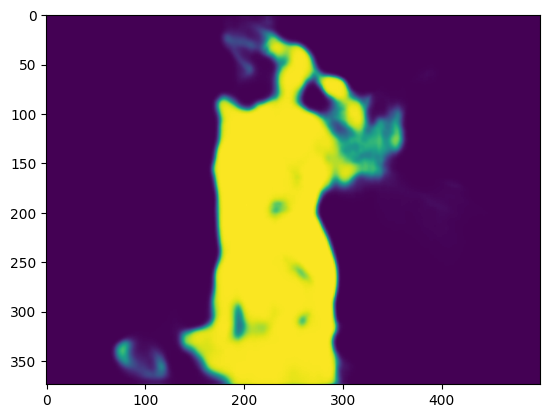

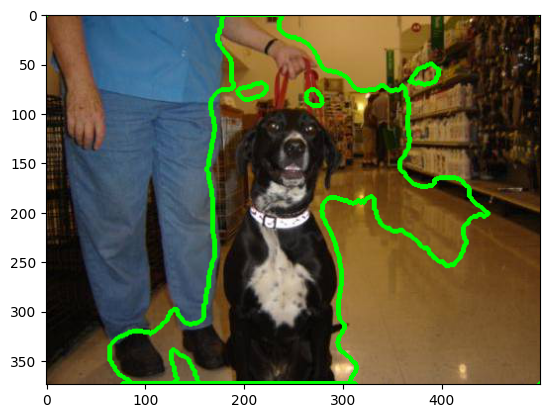

Dog_Segmentation/Images/dog.8873.jpg


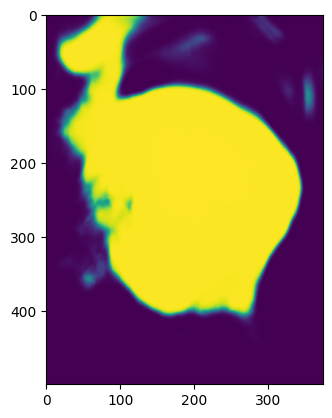

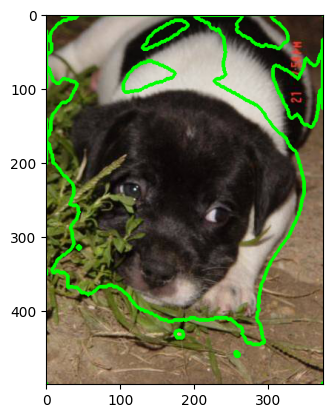

Dog_Segmentation/Images/dog.8822.jpg


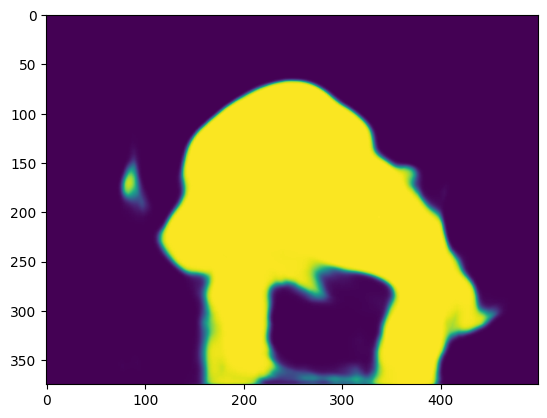

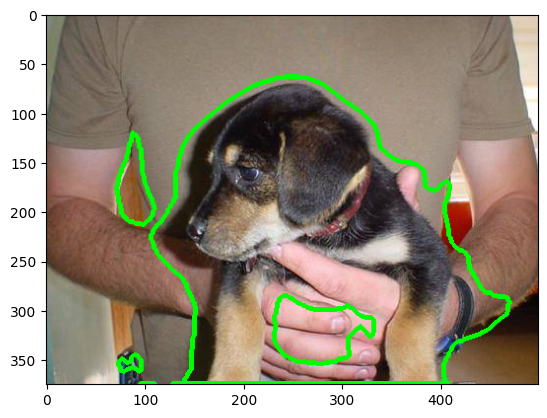

Dog_Segmentation/Images/dog.8897.jpg


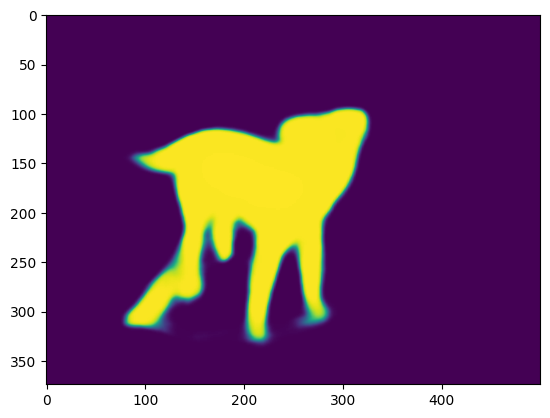

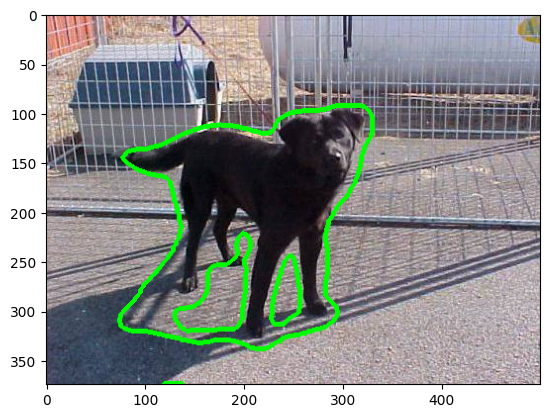

Dog_Segmentation/Images/dog.8818.jpg


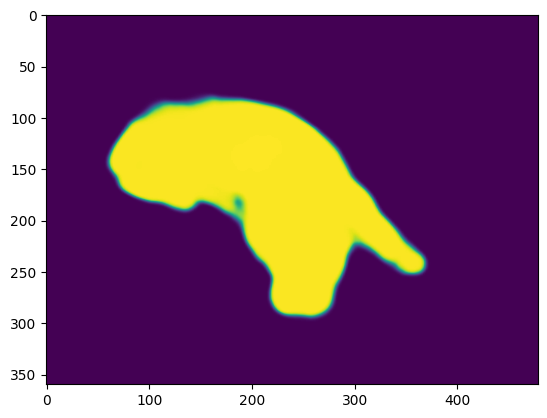

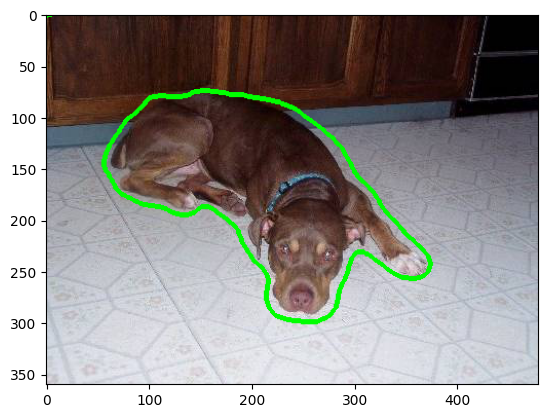

Dog_Segmentation/Images/dog.8892.jpg


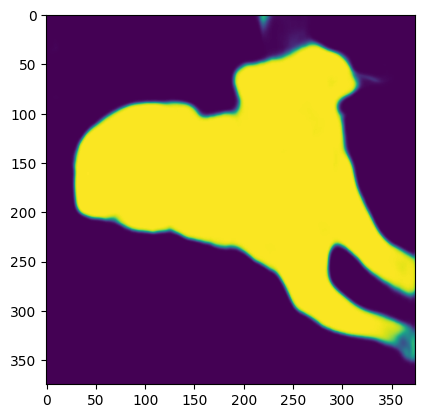

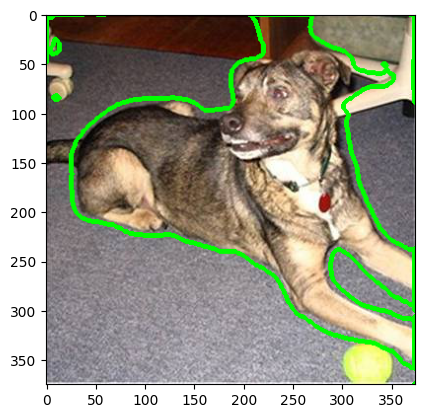

In [64]:
for img in val_img_list:
    print(img)
    ori = Image.open(img)
    np_image = np.array(ori)
    mask, image = predict(ori, model_dir)
    plt.imshow(np.array(mask))
    plt.show()
    
    contours, hierarchy = cv2.findContours(np.array(mask), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    cv2.drawContours(np_image, contours, -1, (0,255,0), 3)
    plt.imshow(np_image)
    plt.show()

In [65]:
def compute_iou(mask1, mask2):
    intersection = np.logical_and(mask1, mask2)
    union = np.logical_or(mask1, mask2)
    iou_score = np.sum(intersection) / np.sum(union)
    return iou_score

def compute_recall(pred_mask, gt_mask, iou_threshold=0.7):
    iou_score = compute_iou(pred_mask, gt_mask)
    TP = float(iou_score > iou_threshold)
    FN = float(iou_score <= iou_threshold)
    
    return iou_score, TP, FN


In [66]:
n_TP = 0
n_FN = 0
for i, img in enumerate(train_img_list):
    ori_image = Image.open(img)
    pred_mask, image = predict(ori_image, model_dir)
    gt_mask = Image.open(train_label_list[i])
    iou_score, TP, FN = compute_recall(pred_mask, gt_mask, 0.6)
    print(f'IoU score of the prediction of {img} = {np.round(iou_score, 2)}')
    n_TP = n_TP + TP
    n_FN = n_FN + FN
    
print(f' Recall of training dataset {n_TP / (n_TP + n_FN)}')

IoU score of the prediction of Dog_Segmentation/Images/dog.8900.jpg = 0.85
IoU score of the prediction of Dog_Segmentation/Images/dog.8891.jpg = 0.8
IoU score of the prediction of Dog_Segmentation/Images/dog.8950.jpg = 0.88
IoU score of the prediction of Dog_Segmentation/Images/dog.8816.jpg = 0.89
IoU score of the prediction of Dog_Segmentation/Images/dog.8789.jpg = 0.88
IoU score of the prediction of Dog_Segmentation/Images/dog.8815.jpg = 0.81
IoU score of the prediction of Dog_Segmentation/Images/dog.8792.jpg = 0.89
IoU score of the prediction of Dog_Segmentation/Images/dog.8840.jpg = 0.92
IoU score of the prediction of Dog_Segmentation/Images/dog.8917.jpg = 0.92
IoU score of the prediction of Dog_Segmentation/Images/dog.8927.jpg = 0.93
IoU score of the prediction of Dog_Segmentation/Images/dog.8864.jpg = 0.92
IoU score of the prediction of Dog_Segmentation/Images/dog.8871.jpg = 0.89
IoU score of the prediction of Dog_Segmentation/Images/dog.8930.jpg = 0.78
IoU score of the predictio

In [67]:
recall = 0
for i, img in enumerate(val_img_list):
    ori_image = Image.open(img)
    pred_mask, image = predict(ori_image, model_dir)
    gt_mask = Image.open(val_label_list[i])
    iou_score, TP, FN = compute_recall(pred_mask, gt_mask, 0.6)
    print(f'IoU score of the prediction of {img} = {np.round(iou_score, 2)}')
    n_TP = n_TP + TP
    n_FN = n_FN + FN
    
print(f' Recall of validation dataset {n_TP / (n_TP + n_FN)}')

IoU score of the prediction of Dog_Segmentation/Images/dog.8870.jpg = 0.59
IoU score of the prediction of Dog_Segmentation/Images/dog.8802.jpg = 0.64
IoU score of the prediction of Dog_Segmentation/Images/dog.8925.jpg = 0.55
IoU score of the prediction of Dog_Segmentation/Images/dog.8956.jpg = 0.93
IoU score of the prediction of Dog_Segmentation/Images/dog.8800.jpg = 0.67
IoU score of the prediction of Dog_Segmentation/Images/dog.8965.jpg = 0.8
IoU score of the prediction of Dog_Segmentation/Images/dog.8836.jpg = 0.83
IoU score of the prediction of Dog_Segmentation/Images/dog.8837.jpg = 0.92
IoU score of the prediction of Dog_Segmentation/Images/dog.8812.jpg = 0.63
IoU score of the prediction of Dog_Segmentation/Images/dog.8931.jpg = 0.64
IoU score of the prediction of Dog_Segmentation/Images/dog.8856.jpg = 0.76
IoU score of the prediction of Dog_Segmentation/Images/dog.8903.jpg = 0.72
IoU score of the prediction of Dog_Segmentation/Images/dog.8865.jpg = 0.73
IoU score of the predictio

### Evaluate model performance on different sizes of objects

#### Large size object which achieves 0.6 IoU Score

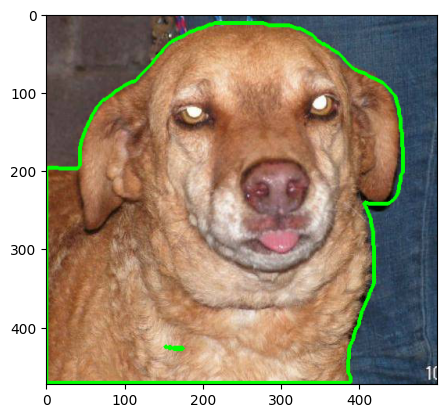

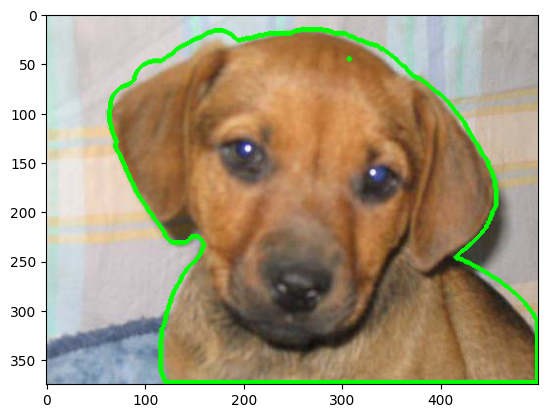

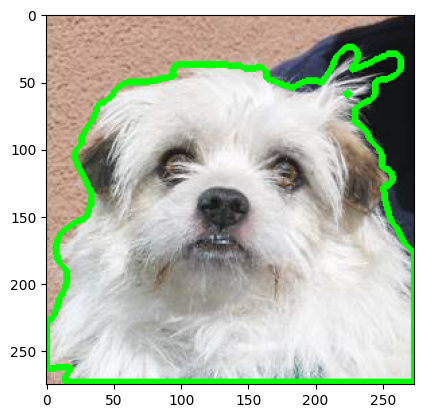

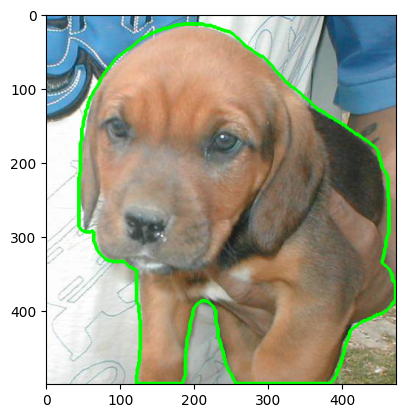

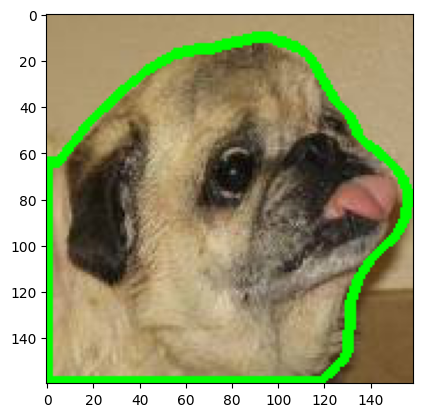

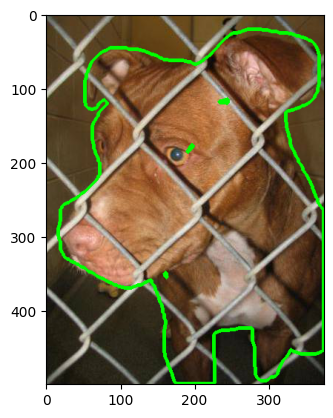

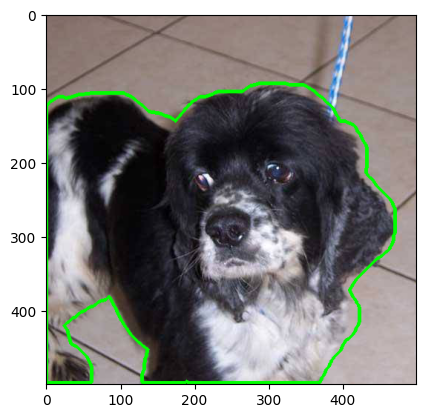

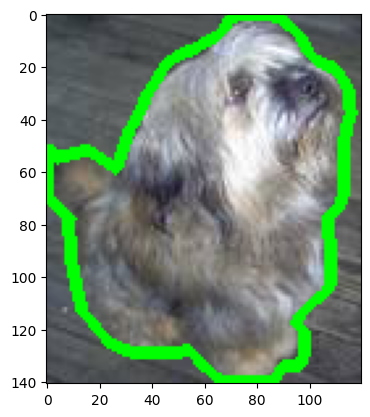

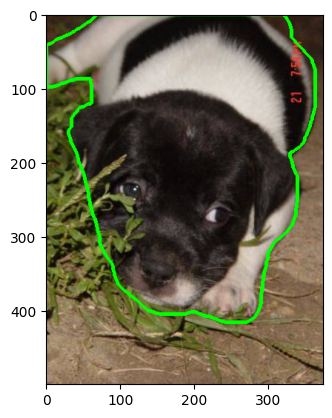

In [68]:
count = 0
large_len = 0
for i, mask in enumerate(val_label_list):
    mask = cv2.imread(mask, cv2.IMREAD_GRAYSCALE)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    largest_contour = max(contours, key = cv2.contourArea) # Get the largest contour if there are multiple
    segmentation_area = cv2.contourArea(largest_contour)
    total_area = mask.size
    percentage = (segmentation_area / total_area) * 100

    if percentage >= 60:
        large_len += 1
        ori_image = Image.open(val_img_list[i])
        np_image = np.array(ori_image)
        pred_mask, image = predict(ori_image, model_dir)
        iou_score = compute_iou(pred_mask, Image.fromarray(mask))
        
        if iou_score > 0.6:
            contours, hierarchy = cv2.findContours(np.array(mask), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
            cv2.drawContours(np_image, contours, -1, (0,255,0), 3)
            plt.imshow(np_image)
            plt.show()
            count += 1
        

In [69]:
print(f'{count} out of {large_len} achieves IoU score > 0.6')

9 out of 10 achieves IoU score > 0.6


#### Medium size object which achieves 0.6 IoU Score

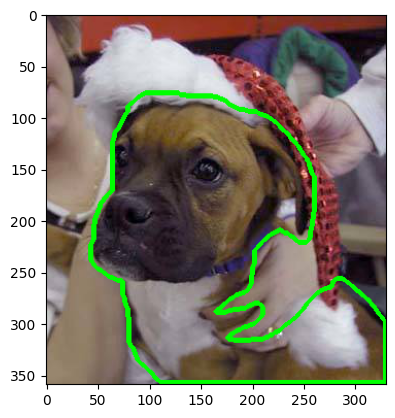

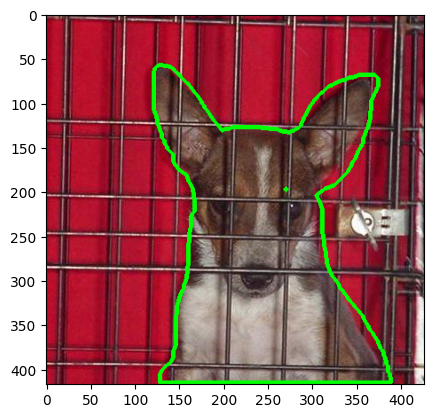

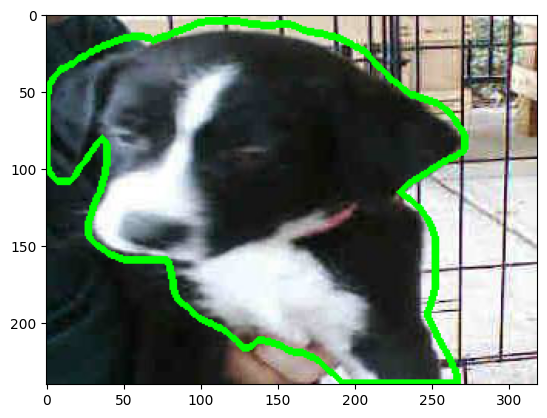

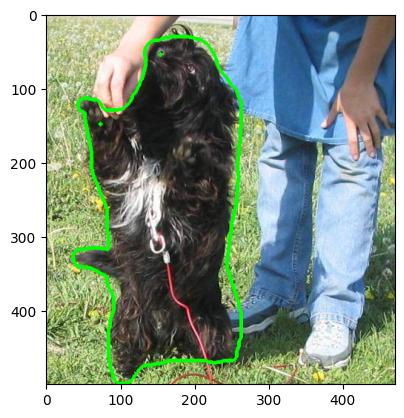

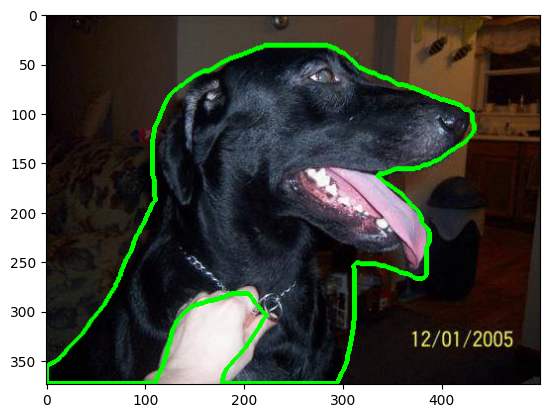

...

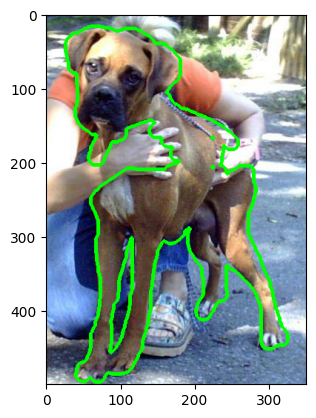

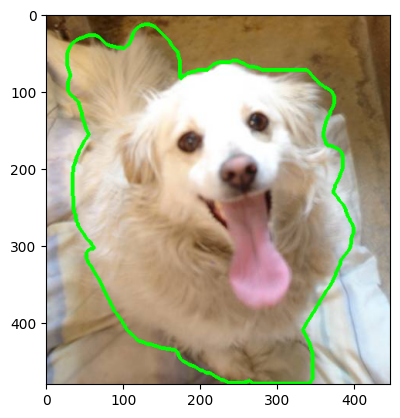

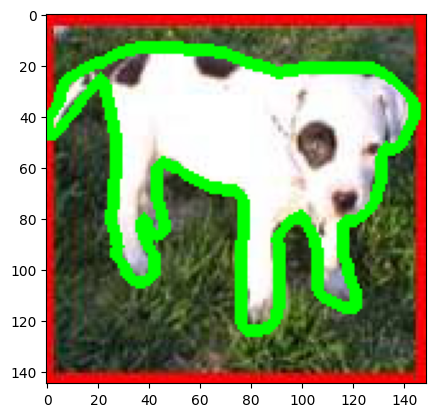

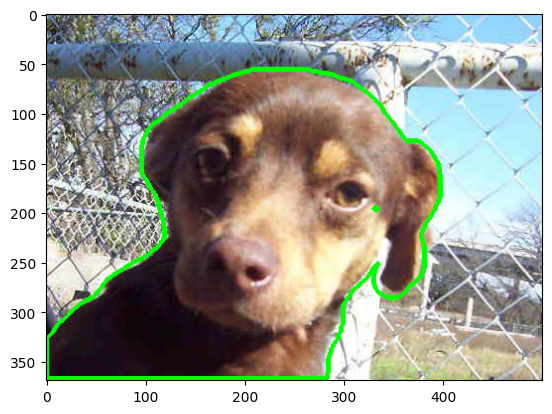

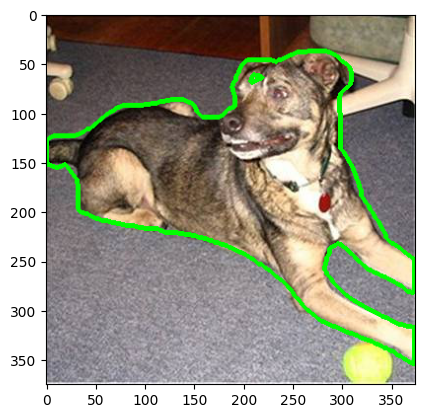

In [70]:
count = 0
medium_len = 0
for i, mask in enumerate(val_label_list):
    mask = cv2.imread(mask, cv2.IMREAD_GRAYSCALE)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    largest_contour = max(contours, key = cv2.contourArea) # Get the largest contour if there are multiple
    segmentation_area = cv2.contourArea(largest_contour)
    total_area = mask.size
    percentage = (segmentation_area / total_area) * 100

    if percentage < 60 and percentage > 30:
        medium_len += 1
        ori_image = Image.open(val_img_list[i])
        np_image = np.array(ori_image)
        pred_mask, image = predict(ori_image, model_dir)
        iou_score = compute_iou(pred_mask, Image.fromarray(mask))
        
        if iou_score > 0.6:
            contours, hierarchy = cv2.findContours(np.array(mask), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
            cv2.drawContours(np_image, contours, -1, (0,255,0), 3)
            plt.imshow(np_image)
            plt.show()
            count += 1

In [71]:
print(f'{count} out of {medium_len} achieves IoU score > 0.6')

19 out of 24 achieves IoU score > 0.6


#### Small size object which achieves 0.6 IoU Score

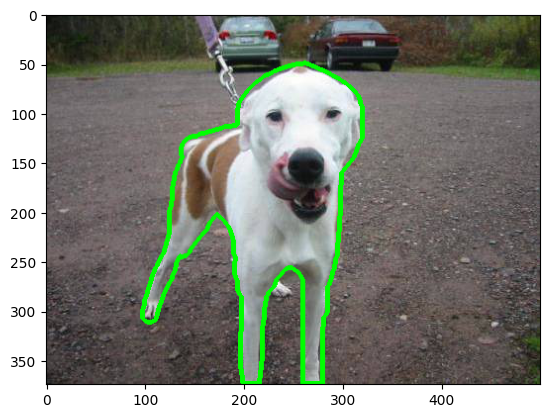

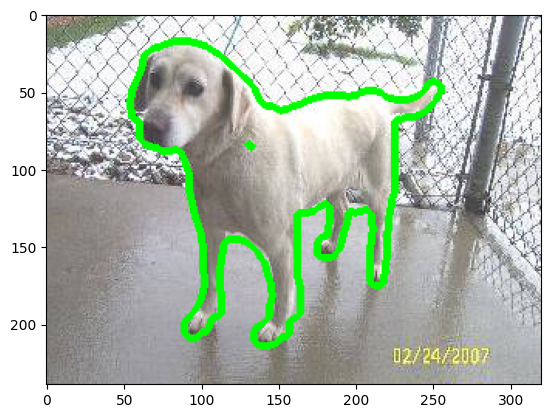

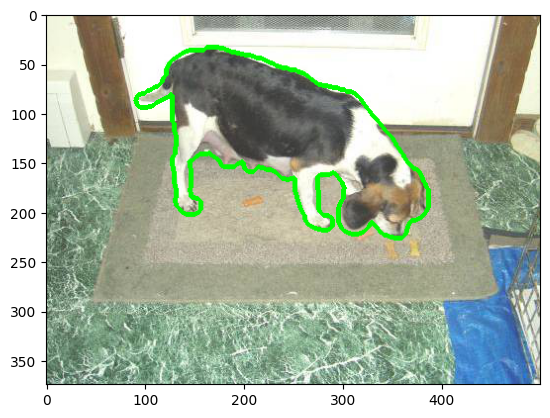

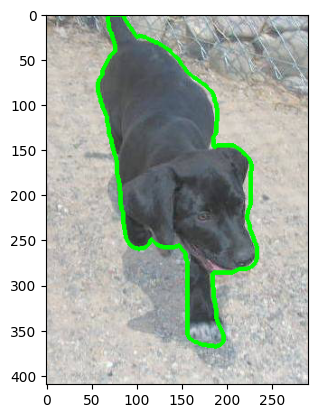

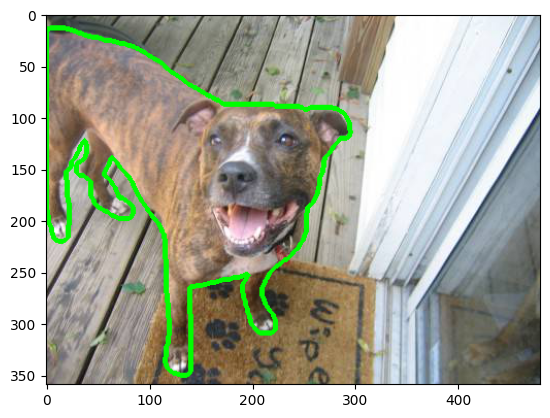

...

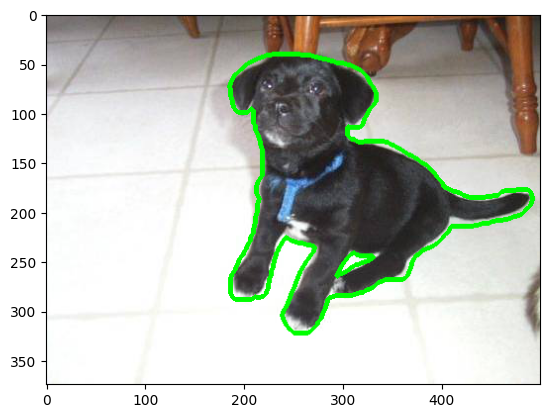

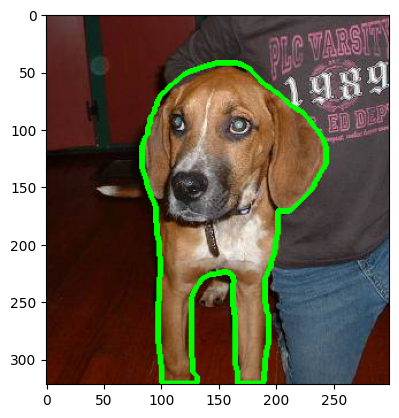

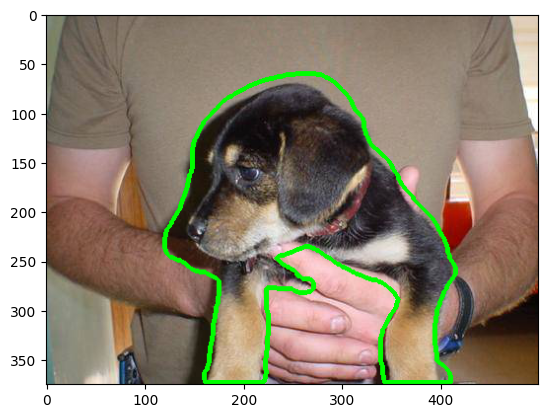

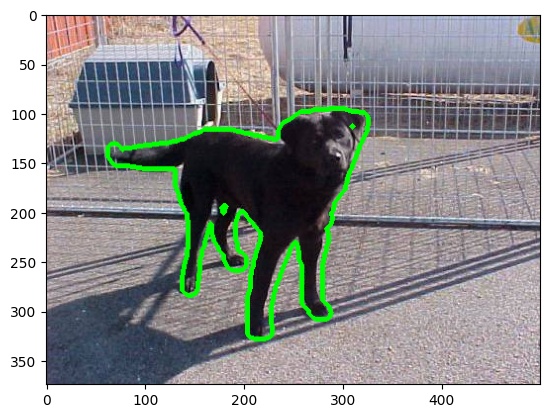

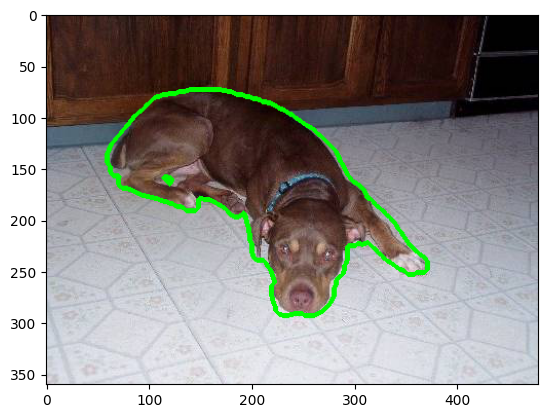

In [72]:
count = 0
small_len = 0
for i, mask in enumerate(val_label_list):
    mask = cv2.imread(mask, cv2.IMREAD_GRAYSCALE)
    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    largest_contour = max(contours, key = cv2.contourArea) # Get the largest contour if there are multiple
    segmentation_area = cv2.contourArea(largest_contour)
    total_area = mask.size
    percentage = (segmentation_area / total_area) * 100

    if percentage <= 30:
        small_len += 1
        ori_image = Image.open(val_img_list[i])
        np_image = np.array(ori_image)
        pred_mask, image = predict(ori_image, model_dir)
        iou_score = compute_iou(pred_mask, Image.fromarray(mask))
        
        if iou_score > 0.6:
            contours, hierarchy = cv2.findContours(np.array(mask), cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
            cv2.drawContours(np_image, contours, -1, (0,255,0), 3)
            plt.imshow(np_image)
            plt.show()
            count += 1
        

In [73]:
print(f'{count} out of {small_len} achieves IoU score > 0.6')

15 out of 21 achieves IoU score > 0.6


## Conclusion

The mdoel achieves Recall <b>100%</b> on training dataset and <b>93.33%</b> on validation dataset. The model overfits on training dataset. To address the overfitting, <b>data augmentation</b> is a good approach to do to increase the number data in both training and validation dataset as well as to increase the varieties of data.